
## Descripción Productos del Sector Agropecuario 2018 - 2023

El objetivo de este análisis es describir el comportamiento que han tenido los productos del sector agropecuario durante el periodo que va desde 2018 hasta el primer cuatrimestre del año 2023. Para este análisis, nos concentraremos en dos componentes, el de precios y el de abastecimiento. En este notebook, el análisis será más general, reuniendo los productos por grupos y encontrando tendencias y patrones para estos. Un dashboard para analizar cada producto individualmente (para los que  se disponga de datos suficientes) hace parte de este repositorio, esto en caso de que se requiera un análisis con este nivel de detalle. Para un resumen de los hallazgos, puede dirigirse al reporte final tambien en este repositorio.

## Data

Los datos para este ejercicio pertenecen al Departamento Administrativo Nacional de Estádistica (Dane), se puede acceder a ellos por medio del siguiente enlace:

* https://www.datos.gov.co/Estad-sticas-Nacionales/Sistema-de-Informaci-n-de-Precios-y-Abastecimiento/ugru-ez98

No tomaremos en cuenta los años de 2013 a 2017 debido a que en el componente de abastecimiento, no se especifica la unidad de medida para la cantidad de producto ingresado, quizá con una comunicación posterior se pueda ampliar este análisis, pero por el momento los datos que usaremos están compuestos de esta forma:

* **Componente Abastecimiento:** Tenemos once archivos .csv, cada uno cubriendo un semestre desde 2018 hasta 2023 (de este año solo el primer cuatrimestre) de manera mensual. Cada archivo contiene la cantidad de producto en kg que se entrega, a que lugar llega, de donde viene, la fecha en que fue entregado y a que categoría pertenece.

* **Componente Precio:** Tenemos seis archivos .csv, cada uno cubriendo un año desde 2018 hasta 2022, y un archivo con información del primer semestre del 2023, todos de manera mensual. Cada archivo contiene el precio del producto, el lugar donde se registró el precio, la fecha en que se hizo el registro y a que categoría pertenece el producto.

Los datos del componente abastecimiento ya han pasado por un preprocesado debido a que la información venía registrada por días, esto además de no coincidir con el componente precio, tenía como desventaja que el tamaño de los archivos era demasiado para este repositorio. Con el fin de hacer coincidir ambos componentes, se han agrupado los registros de cada mes sumando la cantidad entregada de cada producto por central de abastecimiento y lugar de procedencia. El notebook pre_clean.ipynb contiene información de este proceso.

## Limpieza y preparación de los datos

Lo primero que vamos a hacer es reunir los diversos archivos que tenemos por componente en un dataframe, así tendremos un dataframe para el componente de abastecimiento y otro para el componente de precios.

#### Componente abastecimiento

Los archivos contienen la misma información pero sus encabezados son distintos, vamos a cargar cada uno y a observar su esquema:

In [1]:
# Primero importemos las librerias necesarias para este análisis
import pandas as pd
import numpy as np
import os
import plotly.express as px
import plotly.graph_objects as go

#Ahora leamos los archivos .csv para el componente abastecimiento, los encontramos en la siguiente ruta 
ruta = 'datasets/abastecimiento/'
#listamos todos los archivos en un lista
archivos_abastecimiento = os.listdir(ruta)
#Ordenamos los archivos de forma ascendente por año
archivos_abastecimiento = sorted(archivos_abastecimiento)

# Cargamos cada archivo en una lista de dataframes
df_abastecimiento = []
for archivo in archivos_abastecimiento:
    # Al escribir ruta + archivo obtenemos algo como 'datasets/abastecimiento/2018_01_abastecimiento.csv',
    # además es necesario utilizar el enconding latin-1 por los carácteres especiales en los
    # nombres de los departamentos y municipios.
    df_abastecimiento.append(pd.read_csv(ruta + archivo, sep =';', encoding = 'latin-1', decimal = ','))

# Como sabemos que algunos archivos difieren en el nombre de sus columnas vamos a encontrar, cuáles son y cómo difieren.
#Vamos a comparar todos los dataframes con el del primer semestre de 2018,veamos sus columnas
puntero = df_abastecimiento[0]
puntero.columns

Index(['Fuente', 'Cod. Depto Proc.', 'Cod. Municipio Proc.',
       'Departamento Proc.', 'Municipio Proc.', 'Grupo', 'Ali',
       'FechaEncuesta', 'Cant Kg'],
      dtype='object')

In [2]:
#Ahora vamos a compararlo con los otros dataframes y cada vez que encontremos uno que sea diferente en las columnas,
#cambiaremos el puntero a ese dataframe e imprimiremos las columnas que posee.
for df in df_abastecimiento:
    if np.any(df.columns != puntero.columns):
        puntero = df 
        print(puntero.columns) 
    print(df.columns == puntero.columns)

[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]
Index(['Cuidad, Mercado Mayorista', 'Código Departamento',
       ' Código Municipio ', 'Departamento Proc.', 'Municipio Proc.', 'Grupo',
       'Alimento', 'Fecha', 'Cant Kg'],
      dtype='object')
[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]
[ True  True  True  True  True  True  True  True  True]


In [3]:
#Por el resultado anterior sabemos que tenemos dos formas de nombrar las columnas, por lo que los dataframes quedan divididos
#en dos grupos, uno de siete y el otro de cuatro. También nos damos cuenta que, aunque difieren en los nombres, el orden en las
#columnas es el mismo. Por ejemplo:
df_abastecimiento[0].iloc[:1]

,Fuente,Cod. Depto Proc.,Cod. Municipio Proc.,Departamento Proc.,Municipio Proc.,Grupo,Ali,FechaEncuesta,Cant Kg
0,"Armenia, Mercar",'05,'05001,ANTIOQUIA,MEDELLÍN,PROCESADOS,Bebidas otras,2018-01-01,1000.0


In [4]:
df_abastecimiento[10].iloc[:1]

,"Cuidad, Mercado Mayorista",Código Departamento,Código Municipio,Departamento Proc.,Municipio Proc.,Grupo,Alimento,Fecha,Cant Kg
0,"Armenia, Mercar",'05,'05001,ANTIOQUIA,MEDELLÍN,FRUTAS,Tomate de árbol,2023-01-01,11250.0


In [5]:
#Ahora que estamos seguros de como estan nombrados y ordenados nuestros datos, vamos a utilizar los siguientes nombres para 
#las columnas:
nombres_columnas = ['Ciudad, Mercado Mayorista', 'Codigo Departamento', 'Codigo Municipio',
                    'Departamento Proc.', 'Municipio Proc.', 'Grupo','Alimento', 'Fecha', 'Cant Kg']
#Renombramos las columnas de todos los dataframes
for df in df_abastecimiento:
    nuevos_nombres = dict(zip(df.columns, nombres_columnas))
    df.rename(columns= nuevos_nombres, inplace = True)
#ahora todos tienen los mismos nombres veamos por ejemplo los dos dataframes anteriores:
print(df_abastecimiento[0].columns)
print(df_abastecimiento[10].columns)

Index(['Ciudad, Mercado Mayorista', 'Codigo Departamento', 'Codigo Municipio',
       'Departamento Proc.', 'Municipio Proc.', 'Grupo', 'Alimento', 'Fecha',
       'Cant Kg'],
      dtype='object')
Index(['Ciudad, Mercado Mayorista', 'Codigo Departamento', 'Codigo Municipio',
       'Departamento Proc.', 'Municipio Proc.', 'Grupo', 'Alimento', 'Fecha',
       'Cant Kg'],
      dtype='object')


In [6]:
#Ahora podemos concatenarlos en un solo dataframe que tenga toda la información sobre el componente abastecimiento
abastecimiento_df = pd.concat(df_abastecimiento)
#Veamos información general del nuevo dataframe
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 917491 entries, 0 to 58324
Data columns (total 9 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   Ciudad, Mercado Mayorista  917491 non-null  object 
 1   Codigo Departamento        917491 non-null  object 
 2   Codigo Municipio           917491 non-null  object 
 3   Departamento Proc.         917491 non-null  object 
 4   Municipio Proc.            917491 non-null  object 
 5   Grupo                      917491 non-null  object 
 6   Alimento                   917491 non-null  object 
 7   Fecha                      917491 non-null  object 
 8   Cant Kg                    917491 non-null  float64
dtypes: float64(1), object(8)
memory usage: 70.0+ MB


In [7]:
#Para este análisis no vamos a necesitar el codigo por departamento ni el código por municipio, así que los eliminamos
abastecimiento_df = abastecimiento_df.drop(['Codigo Departamento', 'Codigo Municipio'], axis = 1)
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 917491 entries, 0 to 58324
Data columns (total 7 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   Ciudad, Mercado Mayorista  917491 non-null  object 
 1   Departamento Proc.         917491 non-null  object 
 2   Municipio Proc.            917491 non-null  object 
 3   Grupo                      917491 non-null  object 
 4   Alimento                   917491 non-null  object 
 5   Fecha                      917491 non-null  object 
 6   Cant Kg                    917491 non-null  float64
dtypes: float64(1), object(6)
memory usage: 56.0+ MB


In [8]:
#No existen valores nulos así que no tenemos que limpiarlos, pasamos ahora a verificar los tipos de los datos.
#La única columna que no tiene el tipo de dato que le corresponde es la de Fecha, hacemos el cambio
abastecimiento_df['Fecha'] = pd.to_datetime(abastecimiento_df['Fecha'], dayfirst= True)
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 917491 entries, 0 to 58324
Data columns (total 7 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Ciudad, Mercado Mayorista  917491 non-null  object        
 1   Departamento Proc.         917491 non-null  object        
 2   Municipio Proc.            917491 non-null  object        
 3   Grupo                      917491 non-null  object        
 4   Alimento                   917491 non-null  object        
 5   Fecha                      917491 non-null  datetime64[ns]
 6   Cant Kg                    917491 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(5)
memory usage: 56.0+ MB


In [9]:
#Ahora queremos separar la ciudad de su mercado mayorista en dos columnas distintas.
#Primero veamos que datos unicos existen.
abastecimiento_df['Ciudad, Mercado Mayorista'].sort_values().unique()

array(['Armenia, Mercar', 'Barranquilla, Barranquillita',
       'Barranquilla, Granabastos', 'Bogotá, D.C., Corabastos',
       'Bogotá, D.C., Paloquemao', 'Bogotá, D.C., Plaza Las Flores',
       'Bogotá, D.C., Plaza Samper Mendoza', 'Bucaramanga, Centroabastos',
       'Cali, Cavasa', 'Cali, Santa Elena', 'Cali, Santa Helena',
       'Cartagena, Bazurto', 'Cúcuta, Cenabastos',
       'Cúcuta, La Nueva Sexta', 'Florencia (Caquetá)',
       'Ibagué, Plaza La 21', 'Ipiales (Nariño), Centro de acopio',
       'Manizales, Centro Galerías',
       'Medellín, Central Mayorista de Antioquia',
       'Medellín, Plaza Minorista "José María Villa"',
       'Montería, Mercado del Sur', 'Neiva, Surabastos',
       'Pasto, El Potrerillo', 'Pereira, La 41', 'Pereira, Mercasa',
       'Popayán, Plaza de mercado del barrio Bolívar',
       'Santa Marta (Magdalena)', 'Sincelejo, Nuevo Mercado',
       'Tibasosa (Boyacá), Coomproriente',
       'Tunja, Complejo de Servicios del Sur', 'Valledupar, Merc

In [10]:
#Podemos ver que todos están separados por comas, pero Santa Marta, Tibasosa, Florencia e Ipiales tienen entre paréntesis el 
#departamento. No necesitamos esto, así que eliminamos esa parte
abastecimiento_df['Ciudad, Mercado Mayorista'].replace(to_replace = "\s\(\w+\)", value = "", regex = True, inplace = True)
#Como no hay mercado para Santa Marta ni para Florencia, agregaremos el nombre de la ciudad.
abastecimiento_df['Ciudad, Mercado Mayorista'].replace("Santa Marta", "Santa Marta, Santa Marta", inplace = True)
abastecimiento_df['Ciudad, Mercado Mayorista'].replace("Florencia", "Florencia, Florencia", inplace = True)
#Además Bogotá D.C está separada por comas como Bogotá, D.C, "mercado", tenemos que corregir esto
abastecimiento_df['Ciudad, Mercado Mayorista'].replace(to_replace = ", D.C", value = " D.C", regex = True, inplace = True)
#También podemos corregir este error de Bogotá en Municipio Proc.
abastecimiento_df['Municipio Proc.'].replace(to_replace = ", D.C", value = " D.C", regex = True, inplace = True)
#Tenemos un que corregir el nombre de algunos municipios para que coincida con el otro Dataframe
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'CARTAGENA DE INDIAS', 'Municipio Proc.'] = 'Cartagena'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'SAN JOSÉ DE CÚCUTA', 'Municipio Proc.'] = 'Cúcuta'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'FUENTE DE ORO', 'Municipio Proc.'] = 'Fuentedeoro'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'SANTA CRUZ DE MOMPOX', 'Municipio Proc.'] = 'Mompós'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'PIENDAMÓ', 'Municipio Proc.'] = 'PIENDAMÓ - TUNÍA'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'SOTARÁ PAISPAMBA', 'Municipio Proc.'] = 'SOTARA'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'CUASPUD CARLOSAMA', 'Municipio Proc.'] = 'CUASPÚD'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'ANCUYA', 'Municipio Proc.'] = 'ANCUYÁ'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'SAN JOSÉ DE TOLUVIEJO', 'Municipio Proc.'] = 'TOLÚ VIEJO'
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'GUAPI', 'Municipio Proc.'] = 'GUAPÍ'
#También necesitamos cambiar el nombre de los municipios para los alimentos importados, los vamos a traducir al inglés con el 
#fin de poder representarlos luego en un mapa
countries = {
    'Chile': 'Chile',
    'Estados Unidos De América': 'United States of America',
    'Panamá': 'Panama',
    'Ecuador': 'Ecuador',
    'España': 'Spain',
    'Francia': 'France',
    'Perú': 'Peru',
    'Vietnam': 'Vietnam',
    'China': 'China',
    'Italia': 'Italy',
    'Bolivia': 'Bolivia',
    'Canadá': 'Canada',
    'Brasil': 'Brazil',
    'México': 'Mexico',
    'Argentina': 'Argentina',
    'Venezuela': 'Venezuela',
    'Países Bajos': 'Netherlands',
    'Escocia': 'Scotland',
    'Guatemala': 'Guatemala',
    'Nicaragua': 'Nicaragua',
    'Paraguay': 'Paraguay',
    'Uruguay': 'Uruguay',
    'Bélgica': 'Belgium',
    'Afganistán': 'Afghanistan',
    'Honduras': 'Honduras',
    'India': 'India',
    'Turquia': 'Turkey',
    'Alemania':'Germany',
    'Gran Bretaña': 'United Kingdom',
    'Nueva Zelanda' : 'New Zealand',
    'Grecia' : 'Greece'
}
for country in countries.items():
    abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == country[0].upper(), 'Municipio Proc.'] = country[1]


#Por ultimo aparecen registros con Cali, Santa Elena y Cali, Santa Helena; corresponden al mismo lugar pero hay un error de 
#ortografía, lo corregimos:
abastecimiento_df['Ciudad, Mercado Mayorista'].replace(to_replace = 'Cali, Santa Helena', value = 'Cali, Santa Elena', regex = True, inplace = True)

In [11]:
#Revisamos que los cambios se hayan aplicado
abastecimiento_df['Ciudad, Mercado Mayorista'].sort_values().unique()

array(['Armenia, Mercar', 'Barranquilla, Barranquillita',
       'Barranquilla, Granabastos', 'Bogotá D.C., Corabastos',
       'Bogotá D.C., Paloquemao', 'Bogotá D.C., Plaza Las Flores',
       'Bogotá D.C., Plaza Samper Mendoza', 'Bucaramanga, Centroabastos',
       'Cali, Cavasa', 'Cali, Santa Elena', 'Cartagena, Bazurto',
       'Cúcuta, Cenabastos', 'Cúcuta, La Nueva Sexta',
       'Florencia, Florencia', 'Ibagué, Plaza La 21',
       'Ipiales, Centro de acopio', 'Manizales, Centro Galerías',
       'Medellín, Central Mayorista de Antioquia',
       'Medellín, Plaza Minorista "José María Villa"',
       'Montería, Mercado del Sur', 'Neiva, Surabastos',
       'Pasto, El Potrerillo', 'Pereira, La 41', 'Pereira, Mercasa',
       'Popayán, Plaza de mercado del barrio Bolívar',
       'Santa Marta, Santa Marta', 'Sincelejo, Nuevo Mercado',
       'Tibasosa, Coomproriente', 'Tunja, Complejo de Servicios del Sur',
       'Valledupar, Mercabastos', 'Valledupar, Mercado Nuevo',
       'Vi

In [12]:
#Como todo quedó bien ahora si separamos la Ciudad y el Mercado Mayorista, además cambiaremos ciudad por municipio, ya que 
#es más preciso para referirnos al conjunto de datos que tenemos.
abastecimiento_df.insert(0, "Municipio", abastecimiento_df['Ciudad, Mercado Mayorista'].str.split(r',', expand = True)[0])
abastecimiento_df.insert(1, "Mercado Mayorista", abastecimiento_df['Ciudad, Mercado Mayorista'].str.split(r',', expand = True)[1])
abastecimiento_df.head()

,Municipio,Mercado Mayorista,"Ciudad, Mercado Mayorista",Departamento Proc.,Municipio Proc.,Grupo,Alimento,Fecha,Cant Kg
0,Armenia,Mercar,"Armenia, Mercar",ANTIOQUIA,MEDELLÍN,PROCESADOS,Bebidas otras,2018-01-01,1000.0
1,Armenia,Mercar,"Armenia, Mercar",ANTIOQUIA,MEDELLÍN,PROCESADOS,Galletas,2018-01-05,2400.0
2,Armenia,Mercar,"Armenia, Mercar",ANTIOQUIA,MEDELLÍN,VERDURAS Y HORTALIZAS,Tomate chonto,2018-01-06,14300.0
3,Armenia,Mercar,"Armenia, Mercar",ANTIOQUIA,BARBOSA,FRUTAS,Tomate de árbol,2018-01-05,7000.0
4,Armenia,Mercar,"Armenia, Mercar",ANTIOQUIA,CARAMANTA,FRUTAS,Tomate de árbol,2018-01-01,20000.0


In [13]:
#Ya no necesitamos la columna Ciudad, Mercado Mayorista, así que la eliminamos
abastecimiento_df.drop('Ciudad, Mercado Mayorista', axis = 1, inplace = True)
#También vamos a cambiar el detalle en nuestra gráfica, y solo vamos a contabilizar la cantidad abastecidad hasta el nivel de
#municipio y no de mercado mayorista, así que sumaremos todas las cantidades del alimento, que en cierta fecha correspondan
#al municipio
abastecimiento_df = abastecimiento_df.groupby(['Municipio', 'Departamento Proc.', 'Municipio Proc.', 'Grupo', 'Alimento', 'Fecha']).agg({'Cant Kg':'sum'}).reset_index()

In [14]:
#Finalmente tenemos el siguiente dataframe para el componente de abastecimiento
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 801128 entries, 0 to 801127
Data columns (total 7 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Municipio           801128 non-null  object        
 1   Departamento Proc.  801128 non-null  object        
 2   Municipio Proc.     801128 non-null  object        
 3   Grupo               801128 non-null  object        
 4   Alimento            801128 non-null  object        
 5   Fecha               801128 non-null  datetime64[ns]
 6   Cant Kg             801128 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(5)
memory usage: 42.8+ MB


In [15]:
#En el dataframe de abastecimiento existen duplicados así que vamos a eliminarlos
#Primero veamos cuales son estos duplicados.
abastecimiento_df[abastecimiento_df.duplicated(keep = False)].sort_values(['Fecha', 'Alimento'])

,Municipio,Departamento Proc.,Municipio Proc.,Grupo,Alimento,Fecha,Cant Kg


In [16]:
#Ahora eliminemoslos
abastecimiento_df.drop_duplicates(inplace = True, ignore_index = True)
#Veamos cuantos registros quedaron después de eliminar los duplicados
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 801128 entries, 0 to 801127
Data columns (total 7 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Municipio           801128 non-null  object        
 1   Departamento Proc.  801128 non-null  object        
 2   Municipio Proc.     801128 non-null  object        
 3   Grupo               801128 non-null  object        
 4   Alimento            801128 non-null  object        
 5   Fecha               801128 non-null  datetime64[ns]
 6   Cant Kg             801128 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(5)
memory usage: 42.8+ MB


#### Componente precios

Aquí pasa algo similar a lo que vimos en el caso de abastecimiento, los archivos contienen la misma información pero sus encabezados son distintos, vamos a cargar cada uno y a observar su esquema

In [17]:
#leamos los archivos .csv para el componente precios, y comparamos sus columnas igual que con el componente de abastecimiento 
ruta = 'datasets/precios/'
archivos_precios= os.listdir(ruta)
archivos_precios = sorted(archivos_precios)
df_precios = []
for archivo in archivos_precios:
    df_precios.append(pd.read_csv(ruta + archivo, sep =';', encoding = 'latin-1'))
puntero = df_precios[0]
print(puntero.columns)
for df in df_precios:
    if np.any(df.columns != puntero.columns):
        puntero = df 
        print(puntero.columns) 
    print(df.columns == puntero.columns)

Index(['Fecha', 'Grupo', 'Producto', 'Fuente', 'Precio'], dtype='object')
[ True  True  True  True  True]
Index(['Fecha', 'Grupo', 'Producto', 'Fuente', 'Precio_por_kilogramo'], dtype='object')
[ True  True  True  True  True]
Index(['Fecha', 'Grupo', 'Producto', 'Mercado', 'Precio_por_kilogramo'], dtype='object')
[ True  True  True  True  True]
Index(['Fecha', 'Grupo', 'Producto', 'Mercado',
       'Precio_promedio_por_kilogramo'],
      dtype='object')
[ True  True  True  True  True]
Index(['Fecha', 'Grupo', 'Producto', 'Mercado',
       'Precio promedio por kilogramo*'],
      dtype='object')
[ True  True  True  True  True]
[ True  True  True  True  True]


In [18]:
#Vemos que estos archivos tienen una mayor variedad en la forma de nombrar sus columnas, pero el orden en que aparecen
#es el mismo para todos los archivos, así que pasamos a renombrarlos y a concatenarlos en un solo dataframe
nombres_columnas = ['Fecha', 'Grupo', 'Producto', 'Fuente', 'Precio por kilogramo']
for df in df_precios:
    nuevos_nombres = dict(zip(df.columns, nombres_columnas))
    df.rename(columns= nuevos_nombres, inplace = True)
# ahora todos tienen los mismos nombres veamos por ejemplo:
print(df_precios[0].columns)
print(df_precios[5].columns)



Index(['Fecha', 'Grupo', 'Producto', 'Fuente', 'Precio por kilogramo'], dtype='object')
Index(['Fecha', 'Grupo', 'Producto', 'Fuente', 'Precio por kilogramo'], dtype='object')


In [19]:
#Antes de concatenar tenemos que ver que tenemos un problema con los acentos y la ñ para los dataframes de los años 2022 y 2023
#En las columnas de Fuente y Producto
print(df_precios[5]['Fuente'].unique())
print(df_precios[4]['Producto'].unique())

['Armenia, Mercar' 'Bogot\xa0, D.C., Corabastos'
 'Bucaramanga, Centroabastos' 'Chiquinquir\xa0 (Boyac\xa0)'
 'Duitama (Boyac\xa0), Mercaplaza' 'Florencia (Caquet\xa0)'
 'Ibagu\x82, Plaza La 21' 'Ipiales (Nari¤o), Ipiales somos todos'
 'Medell¡n, Central Mayorista de Antioquia' 'Neiva, Surabastos'
 'Pamplona (Norte de Santander)' 'Pasto, El Potrerillo' 'Pereira, Mercasa'
 'Tibasosa (Boyac\xa0), Coomproriente'
 'Tunja, Complejo de Servicios del Sur' 'Villavicencio, CAV'
 'Yopal (Casanare)' 'Buenaventura (Valle del Cauca)' 'Cali, Cavasa'
 'Cali, Santa Elena' 'Cartago (Valle del Cauca)' 'C£cuta, Cenabastos'
 'Manizales, Centro Galer¡as'
 'Medell¡n, Plaza Minorista "Jos\x82 Mar¡a Villa"'
 'Monter¡a, Mercado del Sur' 'Palmira (Valle del Cauca)' 'Pereira, La 41'
 'Popay\xa0n, Plaza de mercado del barrio Bol¡var' 'San Gil (Santander)'
 'Sincelejo, Nuevo Mercado' 'Socorro (Santander)'
 'Tulu\xa0 (Valle del Cauca)' 'Valledupar, Mercabastos'
 'Valledupar, Mercado Nuevo' 'Arauca (Arauca)' 'Cartag

In [20]:
#Así que vamos a remplazar esos carácteres extraños con los que le corresponden
caracteres_a_remover = {u'\xa0' : 'á', '¤' : 'ñ', 'Ą' : 'í', 'Ł':'ú', u'\x82': 'é', '˘' :'ó', '¡' : 'í', 
                        '¢' :'ó', '£' : 'ú', '¥' :'Ñ', u'\x81': 'ü'}
for caracter in caracteres_a_remover.items():
    df_precios[5].replace(to_replace = caracter[0], value =  caracter[1], regex = True,  inplace = True)
    df_precios[4].replace(to_replace = caracter[0], value =  caracter[1], regex = True,  inplace = True)


In [21]:
#Comprobemos que se hayan corregido los datos
print(df_precios[5]['Fuente'].unique())
print(df_precios[4]['Producto'].unique())

['Armenia, Mercar' 'Bogotá, D.C., Corabastos' 'Bucaramanga, Centroabastos'
 'Chiquinquirá (Boyacá)' 'Duitama (Boyacá), Mercaplaza'
 'Florencia (Caquetá)' 'Ibagué, Plaza La 21'
 'Ipiales (Nariño), Ipiales somos todos'
 'Medellín, Central Mayorista de Antioquia' 'Neiva, Surabastos'
 'Pamplona (Norte de Santander)' 'Pasto, El Potrerillo' 'Pereira, Mercasa'
 'Tibasosa (Boyacá), Coomproriente' 'Tunja, Complejo de Servicios del Sur'
 'Villavicencio, CAV' 'Yopal (Casanare)' 'Buenaventura (Valle del Cauca)'
 'Cali, Cavasa' 'Cali, Santa Elena' 'Cartago (Valle del Cauca)'
 'Cúcuta, Cenabastos' 'Manizales, Centro Galerías'
 'Medellín, Plaza Minorista "José María Villa"'
 'Montería, Mercado del Sur' 'Palmira (Valle del Cauca)' 'Pereira, La 41'
 'Popayán, Plaza de mercado del barrio Bolívar' 'San Gil (Santander)'
 'Sincelejo, Nuevo Mercado' 'Socorro (Santander)'
 'Tuluá (Valle del Cauca)' 'Valledupar, Mercabastos'
 'Valledupar, Mercado Nuevo' 'Arauca (Arauca)' 'Cartagena, Bazurto'
 'Túquerres (Nari

In [22]:
#Ahora ya podemos concatenar todos los dataframes de precios
precios_df = pd.concat(df_precios)

In [23]:
#Vamos a revisar los tipos de datos que tienen nuestra columnas
precios_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 304450 entries, 0 to 26811
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   Fecha                 304450 non-null  object
 1   Grupo                 304450 non-null  object
 2   Producto              304450 non-null  object
 3   Fuente                304450 non-null  object
 4   Precio por kilogramo  304450 non-null  int64 
dtypes: int64(1), object(4)
memory usage: 13.9+ MB


In [24]:
#Necesitamos cambiar el precio_por_kilogramo a float64 y la fecha a datetime
precios_df['Precio por kilogramo'] = precios_df['Precio por kilogramo'].astype(np.float64)
precios_df['Fecha'] = pd.to_datetime(precios_df['Fecha'], dayfirst= True)
#confirmamos que se hayan hecho los cambios
precios_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 304450 entries, 0 to 26811
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Fecha                 304450 non-null  datetime64[ns]
 1   Grupo                 304450 non-null  object        
 2   Producto              304450 non-null  object        
 3   Fuente                304450 non-null  object        
 4   Precio por kilogramo  304450 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(3)
memory usage: 13.9+ MB


In [25]:
#La columna Fuente tiene dos datos, el municipio y, si aplica, el lugar donde se resgistro el precio.
#Así que separaremos está columna en dos nuevas columnas llamadas Municipio y Fuente.
#Para esto veamos los registros unicos en esta columna, ordenados por orden alfabético
print(precios_df['Fuente'].sort_values().unique(),"\n número de registros:", len(precios_df['Fuente'].sort_values().unique()))

['Ancuya (Nariño)' 'Arauca (Arauca)' 'Armenia, Mercar' 'Armenia, Retiro'
 'Barranquilla, Barranquillita' 'Barranquilla, Granabastos'
 'Bogotá, D.C., Corabastos' 'Bogotá, D.C., Frigorífico Ble Ltda.'
 'Bogotá, D.C., Frigorífico Guadalupe' 'Bogotá, D.C., Paloquemao'
 'Bogotá, D.C., Plaza España' 'Bogotá, D.C., Plaza Las Flores'
 'Bucaramanga, Centroabastos' 'Bucaramanga, Frigoríficos'
 'Bucaramanga, Mercados del Centro' 'Bucaramanga, Mercados del centro'
 'Buenaventura (Valle del Cauca)' 'Cali, Cavasa' 'Cali, Galería Alameda'
 'Cali, La Floresta' 'Cali, Santa Elena' 'Cali, Santa Helena'
 'Cali, Siloé' 'Caparrapí (Cundinamarca)' 'Cartagena, Bazurto'
 'Cartago (Valle del Cauca)' 'Charalá (Santander)' 'Chiquinquirá (Boyacá)'
 'Consacá (Nariño)' 'Cúcuta, Cenabastos' 'Cúcuta, La Nueva Sexta'
 'Duitama (Boyacá)' 'Duitama (Boyacá), Mercaplaza'
 'El Carmen de Viboral (Antioquia)' 'El Santuario (Antioquia)'
 'Florencia (Caquetá)' 'Güepsa (Santander)' 'Ibagué, Frigorífico Carlima'
 'Ibagué, Plaza 

In [26]:
#Vemos que hay registros repetidos, pero la mayoría es por el uso de las mayúsculas y mínusculas, vamos a corregir esto:
precios_df['Fuente'] = precios_df['Fuente'].str.title()
#Verificamos si hubo cambios
print(precios_df['Fuente'].sort_values().unique(),"\n número de registros:", len(precios_df['Fuente'].sort_values().unique()))

['Ancuya (Nariño)' 'Arauca (Arauca)' 'Armenia, Mercar' 'Armenia, Retiro'
 'Barranquilla, Barranquillita' 'Barranquilla, Granabastos'
 'Bogotá, D.C., Corabastos' 'Bogotá, D.C., Frigorífico Ble Ltda.'
 'Bogotá, D.C., Frigorífico Guadalupe' 'Bogotá, D.C., Paloquemao'
 'Bogotá, D.C., Plaza España' 'Bogotá, D.C., Plaza Las Flores'
 'Bucaramanga, Centroabastos' 'Bucaramanga, Frigoríficos'
 'Bucaramanga, Mercados Del Centro' 'Buenaventura (Valle Del Cauca)'
 'Cali, Cavasa' 'Cali, Galería Alameda' 'Cali, La Floresta'
 'Cali, Santa Elena' 'Cali, Santa Helena' 'Cali, Siloé'
 'Caparrapí (Cundinamarca)' 'Cartagena, Bazurto'
 'Cartago (Valle Del Cauca)' 'Charalá (Santander)' 'Chiquinquirá (Boyacá)'
 'Consacá (Nariño)' 'Cúcuta, Cenabastos' 'Cúcuta, La Nueva Sexta'
 'Duitama (Boyacá)' 'Duitama (Boyacá), Mercaplaza'
 'El Carmen De Viboral (Antioquia)' 'El Santuario (Antioquia)'
 'Florencia (Caquetá)' 'Güepsa (Santander)' 'Ibagué, Frigorífico Carlima'
 'Ibagué, Plaza La 21' 'Ipiales (Nariño), Centro De

In [27]:
#El único registro que sigue duplicado es el de Cali, Santa Elena, por un error de ortografía, lo corregimos:
precios_df['Fuente'].replace(to_replace = 'Cali, Santa Helena', value = 'Cali, Santa Elena', regex = True, inplace = True)
#Confirmamos el cambio
print(precios_df['Fuente'].sort_values().unique(),"\n número de registros:", len(precios_df['Fuente'].sort_values().unique()))

['Ancuya (Nariño)' 'Arauca (Arauca)' 'Armenia, Mercar' 'Armenia, Retiro'
 'Barranquilla, Barranquillita' 'Barranquilla, Granabastos'
 'Bogotá, D.C., Corabastos' 'Bogotá, D.C., Frigorífico Ble Ltda.'
 'Bogotá, D.C., Frigorífico Guadalupe' 'Bogotá, D.C., Paloquemao'
 'Bogotá, D.C., Plaza España' 'Bogotá, D.C., Plaza Las Flores'
 'Bucaramanga, Centroabastos' 'Bucaramanga, Frigoríficos'
 'Bucaramanga, Mercados Del Centro' 'Buenaventura (Valle Del Cauca)'
 'Cali, Cavasa' 'Cali, Galería Alameda' 'Cali, La Floresta'
 'Cali, Santa Elena' 'Cali, Siloé' 'Caparrapí (Cundinamarca)'
 'Cartagena, Bazurto' 'Cartago (Valle Del Cauca)' 'Charalá (Santander)'
 'Chiquinquirá (Boyacá)' 'Consacá (Nariño)' 'Cúcuta, Cenabastos'
 'Cúcuta, La Nueva Sexta' 'Duitama (Boyacá)'
 'Duitama (Boyacá), Mercaplaza' 'El Carmen De Viboral (Antioquia)'
 'El Santuario (Antioquia)' 'Florencia (Caquetá)' 'Güepsa (Santander)'
 'Ibagué, Frigorífico Carlima' 'Ibagué, Plaza La 21'
 'Ipiales (Nariño), Centro De Acopio'
 'Ipiales (N

In [28]:
#Listo, ahora vamos a quitar el departamento que aparece entre paréntesis pues solo unos municipios lo tienen,
#luego agregaremos el departamento en una nueva columna para todos, cargando un dataset que contiene todos los municipios por
#departamento.
#Hay un caso especial y es el de La Unión-Antioquía y La Unión-Nariño, el proceso de agregar el departamento lo haremos manual 
#para estos dos municipios.
precios_df['Fuente'].replace(to_replace = "La Unión \(Antioquia\)", value = "La Unión Antioquia", regex = True, inplace = True)
precios_df['Fuente'].replace(to_replace = "La Unión \(Nariño\)", value = "La Unión Nariño", regex = True, inplace = True)
precios_df['Fuente'].replace(to_replace = "\s\(.+\)", value = "", regex = True, inplace = True)
precios_df['Fuente'].replace(to_replace = ", D.C", value = " D.C", regex = True, inplace = True)

#Vamos a eliminar los espacios que quedan de este proceso
precios_df['Fuente']= precios_df['Fuente'].str.strip()
#Veamos los cambios
print(precios_df['Fuente'].sort_values().unique(),"\n número de registros:", len(precios_df['Fuente'].sort_values().unique()))

['Ancuya' 'Arauca' 'Armenia, Mercar' 'Armenia, Retiro'
 'Barranquilla, Barranquillita' 'Barranquilla, Granabastos'
 'Bogotá D.C., Corabastos' 'Bogotá D.C., Frigorífico Ble Ltda.'
 'Bogotá D.C., Frigorífico Guadalupe' 'Bogotá D.C., Paloquemao'
 'Bogotá D.C., Plaza España' 'Bogotá D.C., Plaza Las Flores'
 'Bucaramanga, Centroabastos' 'Bucaramanga, Frigoríficos'
 'Bucaramanga, Mercados Del Centro' 'Buenaventura' 'Cali, Cavasa'
 'Cali, Galería Alameda' 'Cali, La Floresta' 'Cali, Santa Elena'
 'Cali, Siloé' 'Caparrapí' 'Cartagena, Bazurto' 'Cartago' 'Charalá'
 'Chiquinquirá' 'Consacá' 'Cúcuta, Cenabastos' 'Cúcuta, La Nueva Sexta'
 'Duitama' 'Duitama, Mercaplaza' 'El Carmen De Viboral' 'El Santuario'
 'Florencia' 'Güepsa' 'Ibagué, Frigorífico Carlima' 'Ibagué, Plaza La 21'
 'Ipiales, Centro De Acopio' 'Ipiales, Ipiales Somos Todos' 'La Ceja'
 'La Unión Antioquia' 'La Unión Nariño' 'Malambo, Atlantico'
 'Malambo, Carnes Y Carnes' 'Manizales, Centro Galerías' 'Marinilla'
 'Medellín, Central Ma

In [29]:
#Ahora separamos el municipio de la fuente del registro
precios_df.insert(0, "Municipio", precios_df['Fuente'].str.split(r',', expand = True)[0])
precios_df.insert(1, "Fuente Registro", precios_df['Fuente'].str.split(r',', expand = True)[1])
precios_df.head()

,Municipio,Fuente Registro,Fecha,Grupo,Producto,Fuente,Precio por kilogramo
0,Armenia,Mercar,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,"Armenia, Mercar",1089.0
1,Barranquilla,Barranquillita,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,"Barranquilla, Barranquillita",2961.0
2,Bogotá D.C.,Corabastos,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,"Bogotá D.C., Corabastos",535.0
3,Bucaramanga,Centroabastos,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,"Bucaramanga, Centroabastos",1500.0
4,Chiquinquirá,None,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,Chiquinquirá,1008.0


In [30]:
#En este dataframe no existen duplicados, así que podemos continuar
precios_df[precios_df.duplicated(keep = False)]

,Municipio,Fuente Registro,Fecha,Grupo,Producto,Fuente,Precio por kilogramo


In [31]:
#Como vemos en el registro de Chiquinquirá, nos quedan en la fuente de registro valores None, como no se específicaba donde
#se tomó este registro, llenaremos estos valores con "No especifica"
precios_df['Fuente Registro'].fillna("No especifica", inplace = True)
#Comprobamos los cambios
precios_df.head()

,Municipio,Fuente Registro,Fecha,Grupo,Producto,Fuente,Precio por kilogramo
0,Armenia,Mercar,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,"Armenia, Mercar",1089.0
1,Barranquilla,Barranquillita,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,"Barranquilla, Barranquillita",2961.0
2,Bogotá D.C.,Corabastos,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,"Bogotá D.C., Corabastos",535.0
3,Bucaramanga,Centroabastos,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,"Bucaramanga, Centroabastos",1500.0
4,Chiquinquirá,No especifica,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,Chiquinquirá,1008.0


In [32]:
#Podemos eliminar la columna Fuente
precios_df.drop('Fuente', axis = 1, inplace = True)
#Necesitamos cambiar el nombre de los municipios para que corresponda con los otros datasets que vamos a usar
precios_df.loc[precios_df['Municipio'] == 'Ancuya', 'Municipio'] = 'Ancuyá'
#Y agregar la columna de departamento, para ello vamos a traer el dataset con la información
departamentos_df = pd.read_csv('datasets/Departamentos.csv', delimiter= ',', encoding='utf-8')
#Veamos que hay en el nuevo dataframe con los departamentos
departamentos_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1123 entries, 0 to 1122
Data columns (total 5 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   REGION                        1123 non-null   object 
 1   CÓDIGO DANE DEL DEPARTAMENTO  1123 non-null   int64  
 2   DEPARTAMENTO                  1123 non-null   object 
 3   CÓDIGO DANE DEL MUNICIPIO     1123 non-null   float64
 4   MUNICIPIO                     1123 non-null   object 
dtypes: float64(1), int64(1), object(3)
memory usage: 44.0+ KB


In [33]:
#No necesitamos las columnas de región, ni las que tienen códigos
departamentos_df.drop(['REGION', 'CÓDIGO DANE DEL DEPARTAMENTO','CÓDIGO DANE DEL MUNICIPIO'], axis = 1, inplace = True)
#Vamos a capitalizar cada palabra de los nombres para que coincida con lo que tenemos en el dataframe de precios
departamentos_df['DEPARTAMENTO'] = departamentos_df['DEPARTAMENTO'].str.title() 
departamentos_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1123 entries, 0 to 1122
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   DEPARTAMENTO  1123 non-null   object
 1   MUNICIPIO     1123 non-null   object
dtypes: object(2)
memory usage: 17.7+ KB


In [34]:
#Vamos a verificar cuantos registros tenemos antes de hacer el merge con el dataframe departamentos
#Para mantener la integridad de los datos
precios_df.count()

Municipio               304450
Fuente Registro         304450
Fecha                   304450
Grupo                   304450
Producto                304450
Precio por kilogramo    304450
dtype: int64

In [35]:
#Ahora hacemosel merge de las dos tablas
precios_df = pd.merge(precios_df, departamentos_df, left_on = 'Municipio', right_on = 'MUNICIPIO', how = 'left')
#Verificamos como quedó el nuevo dataframe
precios_df.count()

Municipio               322141
Fuente Registro         322141
Fecha                   322141
Grupo                   322141
Producto                322141
Precio por kilogramo    322141
DEPARTAMENTO            317918
MUNICIPIO               317918
dtype: int64

In [36]:
#Vemos que aumentaron los registros en el dataframe, esto se debe a que hay municipios con el mismo nombre en 
#distintos departamentos, los buscamos contando cuantos departamentos lista cada municipio
municipios_repetidos = precios_df.groupby('Municipio').agg({'DEPARTAMENTO': 'nunique'})
municipios_repetidos[municipios_repetidos['DEPARTAMENTO'] > 1]

,DEPARTAMENTO
Municipio,
Armenia,2
Florencia,2
Rionegro,2
Santa Bárbara,3


In [37]:
#Teniendo en cuenta el dataset original, eliminamos los matches municipio departamento que no existían en este.
precios_df = precios_df[~((precios_df['Municipio'] == 'Armenia') & (precios_df['DEPARTAMENTO'] != 'Quindío'))]
precios_df = precios_df[~((precios_df['Municipio'] == 'Florencia') & (precios_df['DEPARTAMENTO'] != 'Caquetá'))]
precios_df = precios_df[~((precios_df['Municipio'] == 'Rionegro') & (precios_df['DEPARTAMENTO'] != 'Antioquia'))]
precios_df = precios_df[~((precios_df['Municipio'] == 'Santa Bárbara') & (precios_df['DEPARTAMENTO'] != 'Antioquia'))]
precios_df.count()

Municipio               304450
Fuente Registro         304450
Fecha                   304450
Grupo                   304450
Producto                304450
Precio por kilogramo    304450
DEPARTAMENTO            300227
MUNICIPIO               300227
dtype: int64

In [38]:
#Ahora tenemos la misma cantidad de registros que antes, pero nos damos cuenta que que en las nuevas columnas de 
#Departamento y municipio, nos faltan registros. Esto significa que algunos municipios no hicieron match y debemos
#hacerlo manualmente.
#Veamos que municipios no encontraron su departamento
precios_df[precios_df['DEPARTAMENTO'].isnull()]['Municipio'].unique()

array(['Ubaté', 'El Carmen De Viboral', 'La Unión Nariño',
       'La Unión Antioquia', 'Consacá', 'San Sebastián De Mariquita'],
      dtype=object)

In [39]:
#Agregamos el departamento manualmente
precios_df.loc[precios_df['Municipio'] == 'Ubaté','DEPARTAMENTO'] = 'Cundinamarca'
precios_df.loc[precios_df['Municipio'] == 'El Carmen De Viboral','DEPARTAMENTO'] = 'Antioquia'
precios_df.loc[precios_df['Municipio'] == 'La Unión Nariño','DEPARTAMENTO'] = 'Nariño'
precios_df.loc[precios_df['Municipio'] == 'La Unión Nariño','Municipio'] = 'La Unión'
precios_df.loc[precios_df['Municipio'] == 'La Unión Antioquia','DEPARTAMENTO'] = 'Antioquia'
precios_df.loc[precios_df['Municipio'] == 'La Unión Antioquia','Municipio'] = 'La Unión'
precios_df.loc[precios_df['Municipio'] == 'Ancuya','DEPARTAMENTO'] = 'Nariño'
precios_df.loc[precios_df['Municipio'] == 'Consacá','DEPARTAMENTO'] = 'Nariño'
precios_df.loc[precios_df['Municipio'] == 'San Sebastián De Mariquita','DEPARTAMENTO'] = 'Tolima'
precios_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 304450 entries, 1 to 322140
Data columns (total 8 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Municipio             304450 non-null  object        
 1   Fuente Registro       304450 non-null  object        
 2   Fecha                 304450 non-null  datetime64[ns]
 3   Grupo                 304450 non-null  object        
 4   Producto              304450 non-null  object        
 5   Precio por kilogramo  304450 non-null  float64       
 6   DEPARTAMENTO          304450 non-null  object        
 7   MUNICIPIO             300227 non-null  object        
dtypes: datetime64[ns](1), float64(1), object(6)
memory usage: 20.9+ MB


In [40]:
#Ya no tenemos municipios sin departamento.
# Ahora eliminamos la columna de Municipio repetida, y cambiamos el nombre de DEPARTAMENTO a Departamento, 
#para que coincida con la forma en que hemos nombrado nuestras columnas. Además, ordenamos las columnas para que 
#departamento aparezca al principio
precios_df.drop('MUNICIPIO', axis = 1, inplace = True)
precios_df.rename({'DEPARTAMENTO':'Departamento'}, axis = 1, inplace = True)
precios_df = precios_df.reindex(columns = ['Departamento', 'Municipio', 'Fuente Registro', 'Fecha', 'Grupo', 'Producto',
                              'Precio por kilogramo'])
precios_df.head()

,Departamento,Municipio,Fuente Registro,Fecha,Grupo,Producto,Precio por kilogramo
1,Quindío,Armenia,Mercar,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,1089.0
2,Atlántico,Barranquilla,Barranquillita,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,2961.0
3,Bogotá D.C.,Bogotá D.C.,Corabastos,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,535.0
4,Santander,Bucaramanga,Centroabastos,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,1500.0
5,Boyacá,Chiquinquirá,No especifica,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,1008.0


In [41]:
#Podemos agregar el departamento de destino también al dataFrame de abastecimiento, con el fin de poder comparar por departamento
#Vamos a ver cuantos registros tenemos antes del merge
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 801128 entries, 0 to 801127
Data columns (total 7 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Municipio           801128 non-null  object        
 1   Departamento Proc.  801128 non-null  object        
 2   Municipio Proc.     801128 non-null  object        
 3   Grupo               801128 non-null  object        
 4   Alimento            801128 non-null  object        
 5   Fecha               801128 non-null  datetime64[ns]
 6   Cant Kg             801128 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(5)
memory usage: 42.8+ MB


In [42]:
abastecimiento_df = pd.merge(abastecimiento_df, departamentos_df, left_on = 'Municipio', right_on = 'MUNICIPIO', how = 'left')
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 826393 entries, 0 to 826392
Data columns (total 9 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Municipio           826393 non-null  object        
 1   Departamento Proc.  826393 non-null  object        
 2   Municipio Proc.     826393 non-null  object        
 3   Grupo               826393 non-null  object        
 4   Alimento            826393 non-null  object        
 5   Fecha               826393 non-null  datetime64[ns]
 6   Cant Kg             826393 non-null  float64       
 7   DEPARTAMENTO        826393 non-null  object        
 8   MUNICIPIO           826393 non-null  object        
dtypes: datetime64[ns](1), float64(1), object(7)
memory usage: 56.7+ MB


In [43]:
#Veamos que municipios se repiten
municipios_repetidos = abastecimiento_df.groupby('Municipio').agg({'DEPARTAMENTO': 'nunique'})
municipios_repetidos[municipios_repetidos['DEPARTAMENTO'] > 1]

,DEPARTAMENTO
Municipio,
Armenia,2
Florencia,2


In [44]:
#Eliminamos los municipios que se repiten
abastecimiento_df = abastecimiento_df[~((abastecimiento_df['Municipio'] == 'Armenia') & (abastecimiento_df['DEPARTAMENTO'] != 'Quindío'))]
abastecimiento_df = abastecimiento_df[~((abastecimiento_df['Municipio'] == 'Florencia') & (abastecimiento_df['DEPARTAMENTO'] != 'Caquetá'))]
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 801128 entries, 1 to 826392
Data columns (total 9 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Municipio           801128 non-null  object        
 1   Departamento Proc.  801128 non-null  object        
 2   Municipio Proc.     801128 non-null  object        
 3   Grupo               801128 non-null  object        
 4   Alimento            801128 non-null  object        
 5   Fecha               801128 non-null  datetime64[ns]
 6   Cant Kg             801128 non-null  float64       
 7   DEPARTAMENTO        801128 non-null  object        
 8   MUNICIPIO           801128 non-null  object        
dtypes: datetime64[ns](1), float64(1), object(7)
memory usage: 61.1+ MB


In [45]:
#Y ya tenemos cada municipio con el departamento que le corresponde. Eliminamos la columna duplicada de municipio y renombramos
#y organizamos la columna Departamento.
abastecimiento_df.drop('MUNICIPIO', axis = 1, inplace = True)
abastecimiento_df.rename({'DEPARTAMENTO':'Departamento'}, axis = 1, inplace = True)
abastecimiento_df = abastecimiento_df.reindex(columns = ['Departamento', 'Municipio', 
                                            'Departamento Proc.', 'Municipio Proc.', 'Grupo', 'Alimento', 'Fecha', 'Cant Kg'])
#Verificamos como quedó el nuevo dataframe
abastecimiento_df.head()

,Departamento,Municipio,Departamento Proc.,Municipio Proc.,Grupo,Alimento,Fecha,Cant Kg
1,Quindío,Armenia,AMAZONAS,EL ENCANTO,VERDURAS Y HORTALIZAS,Chócolo mazorca,2018-01-10,1120.0
3,Quindío,Armenia,ANTIOQUIA,APARTADÓ,FRUTAS,Maracuyá,2019-01-11,7500.0
5,Quindío,Armenia,ANTIOQUIA,APARTADÓ,FRUTAS,Maracuyá,2020-01-09,6600.0
7,Quindío,Armenia,ANTIOQUIA,APARTADÓ,"TUBERCULOS, RAICES Y PLATANOS",Plátano hartón verde,2019-01-10,14000.0
9,Quindío,Armenia,ANTIOQUIA,APARTADÓ,"TUBERCULOS, RAICES Y PLATANOS",Plátano hartón verde,2019-01-11,13000.0


In [46]:
#Vamos a estandarizar los datos en las columnas Departamento Proc.,'Municipio Proc.', Grupo y alimento haciendo 
#que todos estén capitalizados
abastecimiento_df['Departamento Proc.'] =abastecimiento_df['Departamento Proc.'].str.title()
abastecimiento_df['Municipio Proc.'] = abastecimiento_df['Municipio Proc.'].str.title()
abastecimiento_df['Grupo'] =abastecimiento_df['Grupo'].str.capitalize()
abastecimiento_df['Alimento'] =abastecimiento_df['Alimento'].str.capitalize()

In [47]:
#Veamos que en la columna Departamento Proc. aparecen dos registro para Bogotá
abastecimiento_df['Departamento Proc.'].sort_values().unique()

array(['Amazonas', 'Antioquia', 'Arauca',
       'Archipiélago De San Andrés, Providencia Y', 'Atlántico',
       'Bogotá, D. C.', 'Bogotá, D.C.', 'Bolívar', 'Boyacá', 'Caldas',
       'Caquetá', 'Casanare', 'Cauca', 'Cesar', 'Chocó', 'Cundinamarca',
       'Córdoba', 'Guainía', 'Guaviare', 'Huila', 'La Guajira',
       'Magdalena', 'Meta', 'Nariño', 'Norte De Santander', 'Otro',
       'Putumayo', 'Quindío', 'Risaralda', 'Santander', 'Sucre', 'Tolima',
       'Valle Del Cauca', 'Vaupés', 'Vichada'], dtype=object)

In [48]:
#Vamos a cambiar esos registros para que tengan el mismo nombre
abastecimiento_df.loc[abastecimiento_df['Departamento Proc.'].str.startswith('Bogotá'), 'Departamento Proc.'] = 'Bogotá D.C.'
#Confirmemos que el cambio se realizó
abastecimiento_df['Departamento Proc.'].sort_values().unique()

array(['Amazonas', 'Antioquia', 'Arauca',
       'Archipiélago De San Andrés, Providencia Y', 'Atlántico',
       'Bogotá D.C.', 'Bolívar', 'Boyacá', 'Caldas', 'Caquetá',
       'Casanare', 'Cauca', 'Cesar', 'Chocó', 'Cundinamarca', 'Córdoba',
       'Guainía', 'Guaviare', 'Huila', 'La Guajira', 'Magdalena', 'Meta',
       'Nariño', 'Norte De Santander', 'Otro', 'Putumayo', 'Quindío',
       'Risaralda', 'Santander', 'Sucre', 'Tolima', 'Valle Del Cauca',
       'Vaupés', 'Vichada'], dtype=object)

In [49]:
#Finalmente tenemos nuestro dataframe de abastecimiento limpio, procesado y listo para el análisis
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 801128 entries, 1 to 826392
Data columns (total 8 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Departamento        801128 non-null  object        
 1   Municipio           801128 non-null  object        
 2   Departamento Proc.  801128 non-null  object        
 3   Municipio Proc.     801128 non-null  object        
 4   Grupo               801128 non-null  object        
 5   Alimento            801128 non-null  object        
 6   Fecha               801128 non-null  datetime64[ns]
 7   Cant Kg             801128 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(6)
memory usage: 55.0+ MB


### Agregando la geolocalización de los municipios

In [50]:
#Ahora para poder realizar algunas visualizaciones en mapas necesitamos agregar las coordenadas geográficas de los municipios, 
#para ello vamos a cargar un dataset que contiene la longitud y la latitud de cada uno.
geocoding_df = pd.read_csv('datasets/geocoding.csv', sep =';', encoding = 'latin-1', decimal = ',')
#Necesitamos que los nombres de municipio y departamento coincidan con el formato que tenemos en nuestro dataset
geocoding_df['Nombre Departamento'] = geocoding_df['Nombre Departamento'].str.title()
geocoding_df['Nombre Municipio'] = geocoding_df['Nombre Municipio'].str.title()
geocoding_df = geocoding_df.rename(columns = {'Nombre Departamento':'Departamento', 'Nombre Municipio':'Municipio'})
geocoding_df

,Departamento,Municipio,Longitud,Latitud
0,Antioquia,Medellín,-75.576002,6.248586
1,Antioquia,Abejorral,-75.428740,5.789301
2,Antioquia,Abriaquí,-76.064295,6.632282
3,Antioquia,Alejandría,-75.141335,6.376063
4,Antioquia,Amagá,-75.701948,6.038808
...,...,...,...,...
1103,Amazonas,El Encanto,-73.207557,-1.747391
1104,Amazonas,Mirití - Paraná,-70.988924,-0.888832
1105,Guainía,Barranco Minas,-69.813248,3.494010
1106,Guainía,Puerto Colombia,-67.566787,2.726466


In [51]:
#Revisemos nuestros dataframes antes de agregar la localización, para evitar que la unión modifiqué
#nuestros datos
precios_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 304450 entries, 1 to 322140
Data columns (total 7 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Departamento          304450 non-null  object        
 1   Municipio             304450 non-null  object        
 2   Fuente Registro       304450 non-null  object        
 3   Fecha                 304450 non-null  datetime64[ns]
 4   Grupo                 304450 non-null  object        
 5   Producto              304450 non-null  object        
 6   Precio por kilogramo  304450 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(5)
memory usage: 18.6+ MB


In [52]:
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 801128 entries, 1 to 826392
Data columns (total 8 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Departamento        801128 non-null  object        
 1   Municipio           801128 non-null  object        
 2   Departamento Proc.  801128 non-null  object        
 3   Municipio Proc.     801128 non-null  object        
 4   Grupo               801128 non-null  object        
 5   Alimento            801128 non-null  object        
 6   Fecha               801128 non-null  datetime64[ns]
 7   Cant Kg             801128 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(6)
memory usage: 55.0+ MB


In [53]:
#Ahora hagamos el merge con precios asignandoselo a un dataframe temporal
temporal_df = pd.merge(precios_df, geocoding_df, on = ['Departamento', 'Municipio'], how = 'left')
temporal_df.head()

,Departamento,Municipio,Fuente Registro,Fecha,Grupo,Producto,Precio por kilogramo,Longitud,Latitud
0,Quindío,Armenia,Mercar,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,1089.0,-75.680755,4.535987
1,Atlántico,Barranquilla,Barranquillita,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,2961.0,-74.813217,10.978320
2,Bogotá D.C.,Bogotá D.C.,Corabastos,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,535.0,-74.106715,4.649937
3,Santander,Bucaramanga,Centroabastos,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,1500.0,-73.132598,7.116268
4,Boyacá,Chiquinquirá,No especifica,2018-01-01,VERDURAS Y HORTALIZAS,Acelga,1008.0,-73.818387,5.614128


In [54]:
#Tenemos algunos valores Nan vamos a revisarlos para ver que sucede, veamos en que municipios y departamentos sucede esto
print('Departamentos:',temporal_df[temporal_df['Longitud'].isnull()]['Departamento'].unique())
print('Municipio:',temporal_df[temporal_df['Longitud'].isnull()]['Municipio'].unique())

Departamentos: ['Cundinamarca' 'Bolívar' 'Antioquia']
Municipio: ['Ubaté' 'Cartagena' 'San Vicente']


In [55]:
#Veamos que pasó con Cartagena
geocoding_df[geocoding_df['Municipio'].str.startswith('Cartagena')]

,Departamento,Municipio,Longitud,Latitud
149,Bolívar,Cartagena De Indias,-75.496426,10.384988
348,Caquetá,Cartagena Del Chairá,-74.847246,1.333117


In [56]:
#Corregimos el problema con Cartagena cambiando el nombre del municipio
geocoding_df.loc[geocoding_df['Municipio'].str.startswith('Cartagena De Indias'), 'Municipio'] = 'Cartagena'
#Ahora veamos que sucede con Ubaté
geocoding_df[geocoding_df['Municipio'].str.contains('Ubaté')]

,Departamento,Municipio,Longitud,Latitud
562,Cundinamarca,Villa De San Diego De Ubaté,-73.814346,5.307541


In [57]:
#Corregimos el problema con Ubaté
precios_df.loc[precios_df['Municipio'].str.contains('Ubaté'), 'Municipio'] = 'Villa De San Diego De Ubaté'
#Veamos que sucede con San Vicente
geocoding_df[geocoding_df['Municipio'].str.contains('San Vicente')]

,Departamento,Municipio,Longitud,Latitud
99,Antioquia,San Vicente Ferrer,-75.332611,6.282152
357,Caquetá,San Vicente Del Caguán,-74.768676,2.119493
918,Santander,San Vicente De Chucurí,-73.411019,6.880379


In [58]:
#Corregimos el problema con San Vicente
precios_df.loc[(precios_df['Municipio'].str.contains('San Vicente')) & (precios_df['Departamento'].str.contains('Antioquia')), 'Municipio'] = 'San Vicente Ferrer'

In [59]:
#Volvemos a hacer el Merge y revisamos si todavía tenemos Nan
temporal_df = pd.merge(precios_df, geocoding_df, on = ['Departamento', 'Municipio'], how = 'left')
print('Departamentos:',temporal_df[temporal_df['Longitud'].isnull()]['Departamento'].head())
print('Municipio:',temporal_df[temporal_df['Longitud'].isnull()]['Municipio'].unique())

Departamentos: Series([], Name: Departamento, dtype: object)
Municipio: []


In [60]:
#Ahora que no tenemos valores NAN podemos hacer permanente este merge
precios_df = pd.merge(precios_df, geocoding_df, on = ['Departamento', 'Municipio'], how = 'left')
#Reindexamos las columnas para que el dataframe esté más ordenado
precios_df = precios_df.reindex(columns = ['Departamento', 'Municipio', 'Fuente Registro', 'Longitud', 'Latitud', 'Fecha', 'Grupo',
                                'Producto', 'Precio por kilogramo'])
precios_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 304450 entries, 0 to 304449
Data columns (total 9 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Departamento          304450 non-null  object        
 1   Municipio             304450 non-null  object        
 2   Fuente Registro       304450 non-null  object        
 3   Longitud              304450 non-null  float64       
 4   Latitud               304450 non-null  float64       
 5   Fecha                 304450 non-null  datetime64[ns]
 6   Grupo                 304450 non-null  object        
 7   Producto              304450 non-null  object        
 8   Precio por kilogramo  304450 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(5)
memory usage: 20.9+ MB


In [61]:
#Ahora agregamos la longitud y la latitud para los Departamentos Proc. y Municipio Proc del dataframe abastecimiento
temporal_df = pd.merge(abastecimiento_df, geocoding_df, left_on = ['Departamento Proc.', 'Municipio Proc.'], right_on = ['Departamento', 'Municipio'], how = 'left', suffixes=('',' P'))
#Los NAN que obtenemos se deben a que los alimentos son importados
temporal_df[temporal_df['Longitud'].isnull()]['Municipio Proc.'].unique()

array(['Argentina', 'Bolivia', 'Brazil', 'Canada', 'Chile', 'China',
       'Ecuador', 'France', 'Italy', 'Peru', 'Spain',
       'United States Of America', 'Uruguay', 'Vietnam', 'Belgium',
       'Mexico', 'Netherlands', 'Panama', 'Paraguay', 'Scotland',
       'Venezuela', 'Afghanistan', 'Germany', 'Greece', 'India',
       'New Zealand', 'Nicaragua', 'Turkey', 'Guatemala',
       'United Kingdom', 'Honduras'], dtype=object)

In [62]:
#Ahora podemos hacer permanente este merge
abastecimiento_df = pd.merge(abastecimiento_df, geocoding_df, left_on = ['Departamento Proc.', 'Municipio Proc.'], right_on = ['Departamento', 'Municipio'], how = 'left', suffixes=('',' P'))
#Eliminamos las columnas duplicadas de Deparatamento y Municipio
abastecimiento_df = abastecimiento_df.drop(['Departamento P', 'Municipio P'], axis = 1)
#Renombramos las columnas de la longitud y latitud del departamento de Procedencia
abastecimiento_df = abastecimiento_df.rename(columns = {'Longitud': 'Longitud Proc.', 'Latitud': 'Latitud Proc.'})
abastecimiento_df = abastecimiento_df.reindex(columns = ['Departamento', 'Municipio', 'Departamento Proc.', 'Municipio Proc.','Longitud Proc.','Latitud Proc.','Grupo', 'Alimento', 'Fecha', 'Cant Kg'])

In [63]:
#Ahora agregamos la longitud y la latitud para los Departamentos y Municipios que son abastecidos del dataframe abastecimiento
temporal_df = pd.merge(abastecimiento_df, geocoding_df, on = ['Departamento', 'Municipio'], how = 'left')
#Los NAN que obtenemos se deben a que los alimentos son importados
temporal_df[temporal_df['Longitud'].isnull()]['Municipio'].unique()

array([], dtype=object)

In [64]:
#Podemos hacer el merge permanente
abastecimiento_df = pd.merge(abastecimiento_df, geocoding_df, on = ['Departamento', 'Municipio'], how = 'left')
#Ordenamos las columnas
abastecimiento_df = abastecimiento_df.reindex(columns = ['Departamento', 'Municipio','Longitud','Latitud', 'Departamento Proc.', 'Municipio Proc.','Longitud Proc.','Latitud Proc.','Grupo', 'Alimento', 'Fecha', 'Cant Kg'])


In [65]:
#Necesitamos agregar manualmente la geolocalización de Gramalote en el Norte de Santander
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'Gramalote', 'Latitud Proc.'] = 7.888056
abastecimiento_df.loc[abastecimiento_df['Municipio Proc.'] == 'Gramalote', 'Longitud Proc.'] = -72.796667

In [66]:
#Para el manejo que vamos a hacer nos aclararía mucho tener una columna de abastecimiento en toneladas
abastecimiento_df['Cant Ton'] = abastecimiento_df['Cant Kg']/1000

In [67]:
#Finalmente vemos como quedaron nuestro dataframes
print(precios_df.info())
print(abastecimiento_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 304450 entries, 0 to 304449
Data columns (total 9 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Departamento          304450 non-null  object        
 1   Municipio             304450 non-null  object        
 2   Fuente Registro       304450 non-null  object        
 3   Longitud              304450 non-null  float64       
 4   Latitud               304450 non-null  float64       
 5   Fecha                 304450 non-null  datetime64[ns]
 6   Grupo                 304450 non-null  object        
 7   Producto              304450 non-null  object        
 8   Precio por kilogramo  304450 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(5)
memory usage: 20.9+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 801128 entries, 0 to 801127
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype      

### Merge de los dos dataframes
El dataframe resultante de este Merge es el que usaremos para crear nuestro dashboard por producto.

In [68]:
#En nuestro dataframe de precios, nos falta procesar el texto del grupo para que coincida con el de abastecimiento
precios_df['Grupo'] = precios_df['Grupo'].str.capitalize()
precios_df['Producto'] = precios_df['Producto'].str.capitalize()
#Ahora vemos que grupos tenemos en el dataframe de precios
precios_df['Grupo'].sort_values().unique()

array(['Carnes', 'Frutas', 'Granos y cereales', 'Lacteos y huevos',
       'Lácteos y huevos', 'Pescados', 'Procesados',
       'Tuberculos, raices y platanos', 'Tubérculos, raíces y plátanos',
       'Verduras y hortalizas'], dtype=object)

In [69]:
#Vemos algunas inconsistencias, las corregimos para que coincidan con el dataframe de abastecimiento
precios_df['Grupo'].replace('Lácteos y huevos', 'Lacteos y huevos', inplace = True)
precios_df['Grupo'].replace('Tubérculos, raíces y plátanos', 'Tuberculos, raices y platanos', inplace = True)
precios_df['Grupo'].sort_values().unique()

array(['Carnes', 'Frutas', 'Granos y cereales', 'Lacteos y huevos',
       'Pescados', 'Procesados', 'Tuberculos, raices y platanos',
       'Verduras y hortalizas'], dtype=object)

In [70]:
#Otro problema se presenta con la columna de Alimento en el dataframe de precios, pues los alimentos están registrados
#con mucha especificidad, por ejemplo, no solo se diferencia entre cebolla cabezona blanca y roja sino que además se 
#dividen en categorías cada una, de esta forma no coinciden con los datos que tenemos en el dataframe de abastecimiento que es
#más general. 
#Para solucionarlo, crearemos un dataframe llamado merge, que tenga la misma información de precios, pero añadiendo
#Una columna Alimento, que facilite el merge con el dataframe abastecimiento.
sub_grupo = ['Aceites', 'Aceites', 'Aceites', 'Aceites',  'Acelga', 'Aguacate común','Aguacate hass', 'Aguacate papelillo',
                  'Ahuyama', 'Ahuyamín (sakata)', 'Ajo', 'Ajo importado', 'Ají topito dulce', 'Carne de pollo', 'Carne de pollo',
                  'Almejas con concha', 'Almejas sin concha', 'Apio', 'Arracacha', 'Arracacha', 'Arroz', 'Arroz','Arroz', 'Arroz',
                  'Arroz', 'Arveja amarilla seca importada', 'Arveja enlatada', 'Arveja verde en vaina', 'Arveja verde en vaina',
                  'Arveja verde seca importada', 'Avena', 'Avena', 'Azúcar', 'Azúcar', 'Azúcar', 'Badea', 'Bagre', 'Bagre','Bagre',
                  'Banano bocadillo', 'Banano criollo', 'Banano urabá', 'Basa', 'Basa', 'Berenjena', 'Blanquillo entero fresco', 
                  'Bocachico', 'Bocachico', 'Bocadillo veleño', 'Borojó', 'Breva', 'Brócoli', 'Cachama de cultivo fresca', 'Café',
                  'Café', 'Calabacín', 'Calabaza', 'Calamar anillos', 'Calamar blanco entero',  'Calamar morado entero', 'Camarón',
                  'Camarón', 'Capaz magdalena fresco', 'Carne de cerdo', 'Carne de cerdo', 'Carne de cerdo', 'Carne de cerdo',
                  'Carne de cerdo','Carne de cerdo','Carne de cerdo','Carne de cerdo','Carne de cerdo','Carne de cerdo',
                  'Carne de cerdo','Carne de cerdo','Carne de cerdo', 'Carne de res', 'Carne de res','Carne de res', 'Carne de res',
                  'Carne de res', 'Carne de res','Carne de res', 'Carne de res','Carne de res', 'Carne de res','Carne de res', 
                  'Carne de res','Carne de res', 'Carne de res','Carne de res', 'Carne de res','Carne de res', 'Carne de res',
                  'Carne de res', 'Carne de res', 'Cazuela de mariscos (paquete)', 'Cebolla cabezona blanca', 
                  'Cebolla cabezona blanca', 'Cebolla cabezona blanca', 'Cebolla cabezona blanca', 'Cebolla cabezona roja',
                  'Cebolla cabezona roja',  'Cebolla cabezona roja',  'Cebolla cabezona roja', 'Cebolla junca', 'Cebolla junca',
                  'Cebolla junca','Cebolla junca','Cebolla junca', 'Cebolla puerro', 'Cebollín chino','Chocolate', 'Chocolate',
                  'Chocolate', 'Chócolo mazorca', 'Cidra', 'Cilantro', 'Ciruela importada', 'Ciruela nacional',  'Coco', 'Coles',
                  'Coliflor', 'Color (bolsita)', 'Corvina, filete congelado nacional', 'Cuchuco de cebada', 'Cuchuco de maíz',
                  'Curuba', 'Durazno importado', 'Durazno nacional', 'Espinaca', 'Feijoa', 'Fresa', 'Fríjol','Fríjol','Fríjol',
                  'Fríjol','Fríjol','Fríjol','Fríjol','Fríjol','Fríjol','Fríjol','Fríjol', 'Fríjol verde','Fríjol verde',
                  'Fríjol verde', 'Fríjol', 'Fécula de maíz', 'Galletas', 'Galletas', 'Garbanzo importado', 'Gelatina', 
                  'Granadilla', 'Guanábana', 'Guayabas otras','Guayabas otras', 'Guayaba común', 'Guayabas otras', 'Guayaba pera',
                  'Guayabas otras', 'Gulupa', 'Haba verde', 'Habichuela','Habichuela', 'Harinas','Harinas', 'Higo', 'Huevo','Huevo','Huevo',
                  'Huevo','Huevo','Huevo','Huevo','Huevo', 'Jugo de frutas', 'Jugo instantáneo (sobre)', 'Kiwi', 'Langostino 16-20',
                  'Langostino u12', 'Leche en polvo', 'Lechuga batavia', 'Lechuga crespa verde', 'Lenteja importada', 'Limón común',
                  'Limón común', 'Limón común', 'Limón mandarino', 'Limón tahití', 'Lomitos de atún en lata', 'Lulo',
                  'Mandarina arrayana', 'Mandarina común', 'Mandarina oneco', 'Mango común', 'Mangos otros', 'Mango de azúcar', 
                  'Mangos otros', 'Mangos otros', 'Mangos otros', 'Mango tommy', 'Mango yulima', 'Manteca', 'Manzana nacional', 
                  'Manzana importada', 'Manzana importada', 'Manzana importada', 'Maracuyá','Maracuyá','Maracuyá','Maracuyá',
                  'Maracuyá', 'Margarina', 'Mayonesa doy pack', 'Maíz amarillo', 'Maíz amarillo', 'Maíz amarillo', 'Maíz blanco', 
                  'Maíz blanco', 'Maíz blanco', 'Maíz enlatado', 'Maíz pira', 'Melón cantalup', 'Menudencias de pollo', 
                  'Merluza, filete importado', 'Merluza, filete nacional', 'Mojarra lora entera congelada', 
                  'Mojarra lora entera fresca', 'Mora de castilla', 'Mostaza doy pack', 'Carne de pollo', 'Carne de pollo',
                  'Naranja común', 'Naranja sweet', 'Naranja valencia', 'Nicuro fresco', 'Palmitos de mar', 'Panela','Panela',
                  'Panela','Panela','Panela', 'Papa betina', 'Papa capira', 'Papa criolla limpia', 'Papa criolla sucia',
                  'Papa ica-huila', 'Papa morasurco', 'Papa nevada', 'Papa parda pastusa', 'Papa puracé', 'Papa r-12 negra', 
                  'Papa r-12 roja', 'Papa roja peruana', 'Papa rubí', 'Papa sabanera', 'Papa san félix', 'Papa superior', 
                  'Papa suprema', 'Papa tocarreña', 'Papa única', 'Papaya hawaiana', 'Papaya maradol', 'Papaya melona', 
                  'Papaya paulina', 'Papaya redonda', 'Papaya tainung', 'Pargo rojo entero congelado', 'Pargo rojo entero fresco', 
                  'Pargo rojo platero', 'Pastas alimenticias', 'Patilla', 'Patilla baby', 'Pechuga de pollo', 'Pepino cohombro', 
                  'Pepino de rellenar', 'Pera importada', 'Pera nacional', 'Perejil', 'Pescado cabezas', 'Carne de pollo', 
                  'Carne de pollo', 'Carne de pollo', 'Pimentón', 'Pimentón verde', 'Pitahaya', 'Piña gold', 'Piña manzana', 
                  'Piña perolera', 'Plátanos otros', 'Plátanos otros', 'Plátano hartón verde', 'Plátanos otros', 'Plátano guineo', 
                  'Plátano hartón maduro', 'Plátano hartón verde', 'Plátano hartón verde','Plátano hartón verde','Plátano hartón verde',
                  'Carne de pollo','Carne de pollo','Carne de pollo', 'Quesos y cuajadas','Quesos y cuajadas', 'Queso costeño', 'Quesos y cuajadas',
                  'Quesos y cuajadas', 'Carne de pollo', 'Remolacha','Remolacha','Remolacha','Remolacha', 'Repollo','Repollo','Repollo',
                  'Repollo', 'Rábano rojo', 'Róbalo, filete congelado', 'Sal yodada', 'Salmón, filete congelado', 'Salsa de tomate doy pack',
                  'Sardinas en lata', 'Sierra entera congelada', 'Sopa de pollo (caja)', 'Tangelo', 'Tilapia','Tilapia','Tilapia','Tilapia', 
                  'Tomate chonto', 'Tomate chonto','Tomate chonto', 'Tomate de árbol', 'Tomate larga vida', 'Tomate riogrande',
                  'Tomate riogrande','Tomate riogrande', 'Tomates otros','Tomates otros', 'Toyo blanco, filete congelado', 
                  'Trucha','Trucha', 'Uchuva', 'Ulluco', 'Uva importada', 'Uva isabela', 'Uva negra', 'Uva red globe nacional', 'Uva roja', 
                  'Uva verde', 'Vinagre', 'Yuca', 'Yuca','Yuca','Yuca', 'Zanahoria','Zanahoria','Zanahoria','Zapote', 'Ñame','Ñame','Ñame']
df = pd.DataFrame({'Producto': list(precios_df['Producto'].sort_values().unique()),
                   'Alimento': sub_grupo})
precios_df = pd.merge(precios_df, df, on = 'Producto', how = 'left')
precios_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 304450 entries, 0 to 304449
Data columns (total 10 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Departamento          304450 non-null  object        
 1   Municipio             304450 non-null  object        
 2   Fuente Registro       304450 non-null  object        
 3   Longitud              304450 non-null  float64       
 4   Latitud               304450 non-null  float64       
 5   Fecha                 304450 non-null  datetime64[ns]
 6   Grupo                 304450 non-null  object        
 7   Producto              304450 non-null  object        
 8   Precio por kilogramo  304450 non-null  float64       
 9   Alimento              304450 non-null  object        
dtypes: datetime64[ns](1), float64(3), object(6)
memory usage: 23.2+ MB


In [71]:
#Nos damos cuenta que existen muchos alimentos que podrían pertenecer a un mismo subgrupo, como todos los tomates, las cebollas, etc, así que creamos esta columna
#de subgrupos
precios_df.replace(to_replace= 's\sotros$', value=' otros',regex = True, inplace = True)
precios_df['SubGrupo'] = precios_df['Alimento'].str.split(expand = True)[0]
precios_df.loc[precios_df['SubGrupo'] == 'Guayabas', 'SubGrupo']= 'Guayaba'
precios_df.loc[precios_df['SubGrupo'] == 'Quesos', 'SubGrupo']= 'Queso'
precios_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 304450 entries, 0 to 304449
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Departamento          304450 non-null  object        
 1   Municipio             304450 non-null  object        
 2   Fuente Registro       304450 non-null  object        
 3   Longitud              304450 non-null  float64       
 4   Latitud               304450 non-null  float64       
 5   Fecha                 304450 non-null  datetime64[ns]
 6   Grupo                 304450 non-null  object        
 7   Producto              304450 non-null  object        
 8   Precio por kilogramo  304450 non-null  float64       
 9   Alimento              304450 non-null  object        
 10  SubGrupo              304450 non-null  object        
dtypes: datetime64[ns](1), float64(3), object(7)
memory usage: 25.6+ MB


In [72]:
#Hacemos lo mismo para el dataframe de abastecimiento
abastecimiento_df.replace(to_replace= 's\sotros$', value=' otros',regex = True, inplace = True)
abastecimiento_df['SubGrupo'] = abastecimiento_df['Alimento'].str.split(expand = True)[0]
abastecimiento_df.loc[abastecimiento_df['SubGrupo'] == 'Guayabas', 'SubGrupo']= 'Guayaba'
abastecimiento_df.loc[abastecimiento_df['SubGrupo'] == 'Quesos', 'SubGrupo']= 'Queso'
abastecimiento_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 801128 entries, 0 to 801127
Data columns (total 14 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Departamento        801128 non-null  object        
 1   Municipio           801128 non-null  object        
 2   Longitud            801128 non-null  float64       
 3   Latitud             801128 non-null  float64       
 4   Departamento Proc.  801128 non-null  object        
 5   Municipio Proc.     801128 non-null  object        
 6   Longitud Proc.      775904 non-null  float64       
 7   Latitud Proc.       775904 non-null  float64       
 8   Grupo               801128 non-null  object        
 9   Alimento            801128 non-null  object        
 10  Fecha               801128 non-null  datetime64[ns]
 11  Cant Kg             801128 non-null  float64       
 12  Cant Ton            801128 non-null  float64       
 13  SubGrupo            801128 no

In [73]:
abastecimiento_df[abastecimiento_df['SubGrupo'].isnull()]

,Departamento,Municipio,Longitud,Latitud,Departamento Proc.,Municipio Proc.,Longitud Proc.,Latitud Proc.,Grupo,Alimento,Fecha,Cant Kg,Cant Ton,SubGrupo


In [74]:
#Realmente no nos interesa la fuente donde se registró el precio, pues existen muchos registros en que no se específica,
#para este análisis nos basta con saber en que municipio y departamento se registro este precio, así que podemos eliminar esta columna
#Sin embargo, no podemos simplemente eliminarla, debemos agrupar por departamento y municipio, haciendo el promedio del precio,
#Para evitar duplicados y distorsión de la información, lo mismo debemos hacer con la columna Producto
merge_df = precios_df.groupby(['Departamento', 'Municipio','Longitud','Latitud', 'Fecha', 'Grupo','SubGrupo','Alimento']).agg({'Precio por kilogramo':'mean'}).reset_index()
merge_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 203510 entries, 0 to 203509
Data columns (total 9 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   Departamento          203510 non-null  object        
 1   Municipio             203510 non-null  object        
 2   Longitud              203510 non-null  float64       
 3   Latitud               203510 non-null  float64       
 4   Fecha                 203510 non-null  datetime64[ns]
 5   Grupo                 203510 non-null  object        
 6   SubGrupo              203510 non-null  object        
 7   Alimento              203510 non-null  object        
 8   Precio por kilogramo  203510 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(5)
memory usage: 14.0+ MB


In [75]:
#Hacemos el merge con el dataframe de abastecimiento
merge_df = pd.merge(merge_df, abastecimiento_df, on =['Departamento', 'Municipio','Fecha', 'Grupo','SubGrupo','Alimento'], how = 'inner')
#ordenamos las columnas para ver mejor el dataframe
merge_df.reindex(columns= ['Fecha','Departamento', 'Municipio', 'Longitud', 'Latitud','Departamento Proc.','Municipio Proc.',
                           'Longitud Proc.', 'Latitud Proc.', 'Grupo','SubGrupo', 'Alimento','Precio por kilogramo', 'Cant Kg', 'Cant Ton'])
merge_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51912 entries, 0 to 51911
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Departamento          51912 non-null  object        
 1   Municipio             51912 non-null  object        
 2   Longitud_x            51912 non-null  float64       
 3   Latitud_x             51912 non-null  float64       
 4   Fecha                 51912 non-null  datetime64[ns]
 5   Grupo                 51912 non-null  object        
 6   SubGrupo              51912 non-null  object        
 7   Alimento              51912 non-null  object        
 8   Precio por kilogramo  51912 non-null  float64       
 9   Longitud_y            51912 non-null  float64       
 10  Latitud_y             51912 non-null  float64       
 11  Departamento Proc.    51912 non-null  object        
 12  Municipio Proc.       51912 non-null  object        
 13  Longitud Proc.  

In [76]:
#Revisamos que no hayan quedado duplicados
merge_df[merge_df.duplicated()]

,Departamento,Municipio,Longitud_x,Latitud_x,Fecha,Grupo,SubGrupo,Alimento,Precio por kilogramo,Longitud_y,Latitud_y,Departamento Proc.,Municipio Proc.,Longitud Proc.,Latitud Proc.,Cant Kg,Cant Ton


In [77]:
#Así que quedamos con pocos registros, pero estos son los únicos en que podemos relacionar el precio con el abastecimiento.
merge_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51912 entries, 0 to 51911
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Departamento          51912 non-null  object        
 1   Municipio             51912 non-null  object        
 2   Longitud_x            51912 non-null  float64       
 3   Latitud_x             51912 non-null  float64       
 4   Fecha                 51912 non-null  datetime64[ns]
 5   Grupo                 51912 non-null  object        
 6   SubGrupo              51912 non-null  object        
 7   Alimento              51912 non-null  object        
 8   Precio por kilogramo  51912 non-null  float64       
 9   Longitud_y            51912 non-null  float64       
 10  Latitud_y             51912 non-null  float64       
 11  Departamento Proc.    51912 non-null  object        
 12  Municipio Proc.       51912 non-null  object        
 13  Longitud Proc.  

## Análisis de los datos
Vamos a ver la composición de los diferentes grupos que componen el sector agropecuario, podemos seleccionar el año y en el treemap veremos reflejado en el tamaño la cantidad de abastecimiento en toneladas.

### Abastecimiento

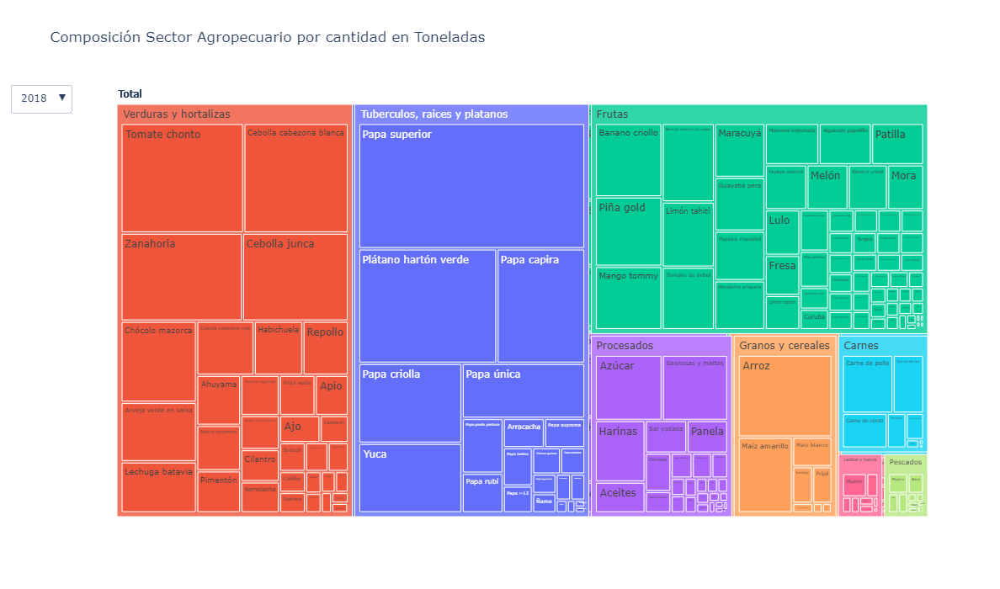

In [78]:
fig = go.Figure()
fechas = list(abastecimiento_df['Fecha'].dt.year.unique())
botones = []

for fecha in fechas:
    botones.append(dict(label=str(fecha),
                        method='update',
                        args=[{"visible": [f == fecha for f in fechas]},
                           {"title": "Composición Sector Agropecuario por cantidad en Toneladas - " + str(fecha)}]))
    fig.add_trace(px.treemap(abastecimiento_df[abastecimiento_df['Fecha'].dt.year == fecha],
                                path = [px.Constant('Total'),'Grupo','Alimento'], 
                                values = 'Cant Ton').to_dict()['data'][0])
    
fig.update_layout(updatemenus = [dict(active=0,buttons= botones,)], height = 700, width = 800, autosize=False)
fig.update_layout(title_text="Composición Sector Agropecuario por cantidad en Toneladas")
fig.show()

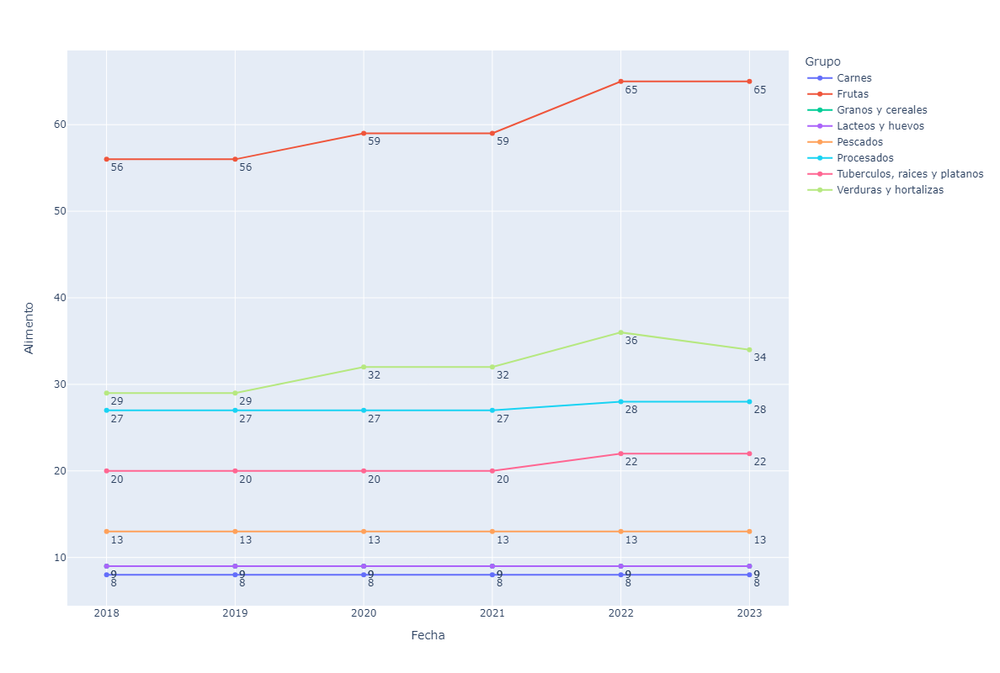

In [79]:
df = abastecimiento_df.groupby([abastecimiento_df['Fecha'].dt.year, 'Grupo','Alimento']).agg({'Cant Ton':'count'}).reset_index()
df = df.drop('Cant Ton', axis = 1)
df = df.groupby(['Fecha','Grupo']).agg({'Alimento':'count'}).reset_index()
fig = px.line(df, x='Fecha', y='Alimento', color = 'Grupo', height = 800,markers = True, text='Alimento')
fig.update_traces(textposition="bottom right")
fig.show()

La mayor cantidad de alimentos abastecidos corresponden a tres grupos:

* Verduras y hortalizas.
* Frutas.
* Tuberculos, raices y platanos.

Esto se ve con mayor claridad en la gráfica de barras que sigue:

(La cantidad en toneladas es menor para el 2023 porque solo estamos tomando en cuenta el primer cuatrimestre de este año)

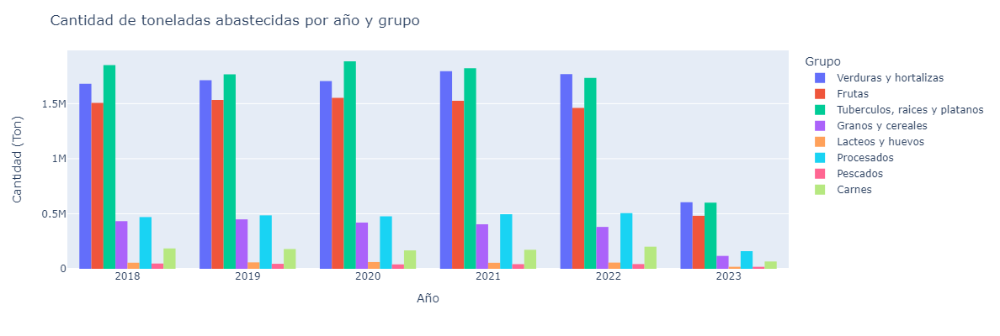

In [80]:
fig = px.histogram(abastecimiento_df,x=abastecimiento_df['Fecha'].dt.year, y="Cant Ton",
             color='Grupo', barmode='group',
             labels={"variable": "Grupo", "x": "Año"},
             height=400)
fig.update_yaxes(title = "Cantidad (Ton)")
fig.update_layout(title_text = "Cantidad de toneladas abastecidas por año y grupo")
fig.show()

Comparemos estos tres grupos contra los otros para ver que porcentaje ocupan:

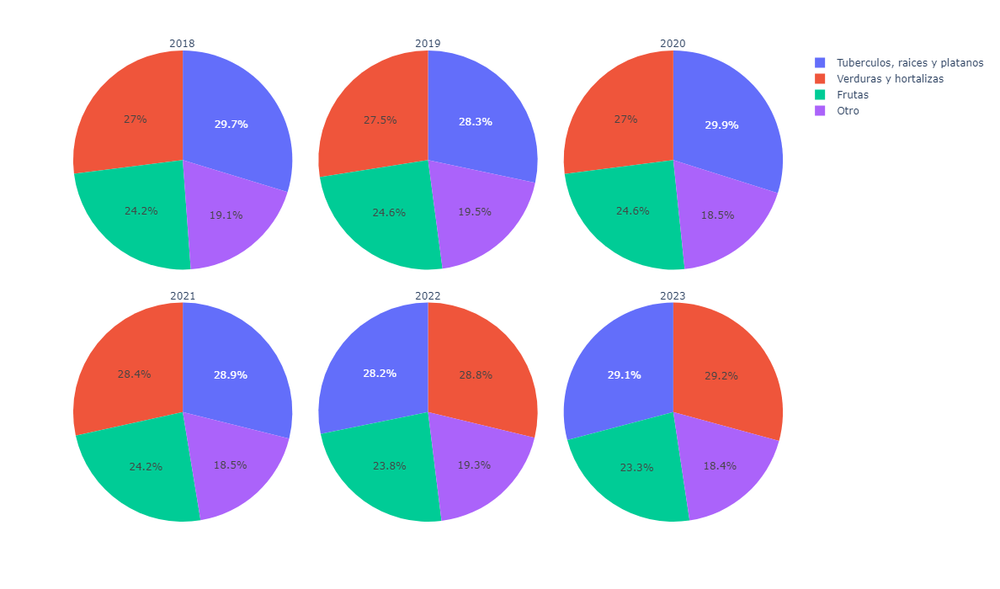

In [81]:
df = abastecimiento_df.groupby(['Fecha', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
df.loc[~((df['Grupo'] == 'Verduras y hortalizas') | (df['Grupo'] == 'Frutas') | (df['Grupo'] == 'Tuberculos, raices y platanos')), 'Grupo'] = 'Otro'
df = df.groupby(['Fecha', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
fig = px.pie(df, values ='Cant Ton', names='Grupo', facet_col = df['Fecha'].dt.year, facet_col_wrap = 3, height = 700)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()


In [82]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año de cada alimento y grupo.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Grupo', 'Alimento']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Grupo', 'Alimento']).agg({'Cant Ton' :'median'}).reset_index()
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
df.head()

,Grupo,Alimento,Cant Ton
145,"Tuberculos, raices y platanos",Papa superior,448498.58000
150,"Tuberculos, raices y platanos",Plátano hartón verde,364181.38887
166,Verduras y hortalizas,Cebolla cabezona,266416.13150
186,Verduras y hortalizas,Tomate chonto,237913.78700
75,Granos y cereales,Arroz,214271.45550


In [83]:
df.tail()

,Grupo,Alimento,Cant Ton
86,Lacteos y huevos,Huevo otros,91.5268
6,Carnes,Pollo en pie,82.3240
54,Frutas,Naranjas otras,74.6050
179,Verduras y hortalizas,Lechugas otras,39.5290
101,Pescados,Pescado seco,34.8350


In [84]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año de cada alimento y grupo.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Grupo', 'Alimento']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Grupo', 'Alimento']).agg({'Cant Ton' :'mean'}).reset_index()
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
df.head()

,Grupo,Alimento,Cant Ton
145,"Tuberculos, raices y platanos",Papa superior,445632.277192
150,"Tuberculos, raices y platanos",Plátano hartón verde,375981.180798
166,Verduras y hortalizas,Cebolla cabezona,251737.371600
186,Verduras y hortalizas,Tomate chonto,237282.875426
191,Verduras y hortalizas,Zanahoria,214897.489932


In [85]:
df.tail()

,Grupo,Alimento,Cant Ton
121,Procesados,Cremas y sopas,162.698036
6,Carnes,Pollo en pie,91.640800
86,Lacteos y huevos,Huevo otros,86.483680
101,Pescados,Pescado seco,65.695000
179,Verduras y hortalizas,Lechugas otras,39.529000


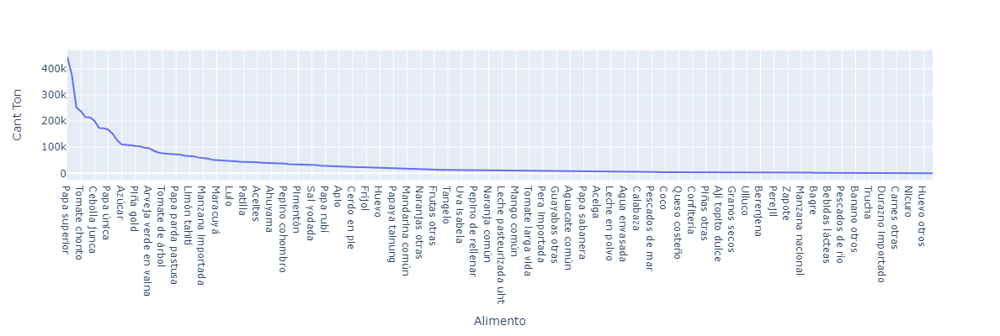

In [86]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año de cada alimento y grupo.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Grupo', 'Alimento']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Grupo', 'Alimento']).agg({'Cant Ton' :'mean'}).reset_index()
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
fig=px.line(df, y = 'Cant Ton',x = 'Alimento', height = 400) 
fig.show()

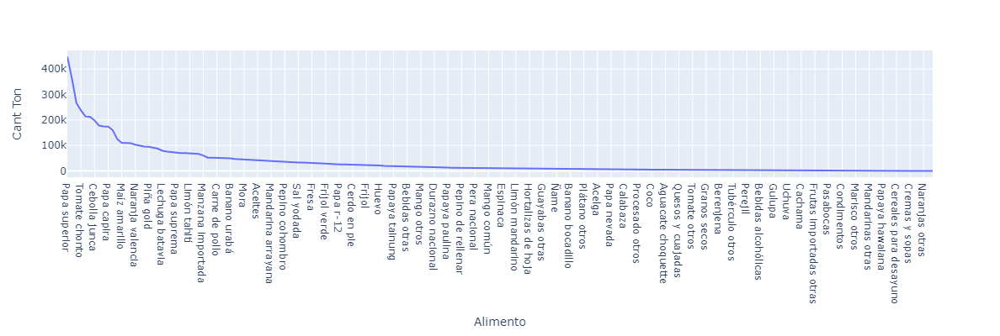

In [87]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año de cada alimento y grupo.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Grupo', 'Alimento']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Grupo', 'Alimento']).agg({'Cant Ton' :'median'}).reset_index()
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
fig=px.line(df, y = 'Cant Ton',x = 'Alimento', height = 400) 
fig.show()

Queda claro que estos tres grupos a lo largo de los años analizados, ocupan poco más del 80% cada año. 
Ahora veamos la cantidad abastecida a cada municipio del que tenemos datos, podemos dar clic en la etiqueta del grupo que 
queramos ver especificamente, allí veremos la cantidad abastecida filtrada por grupo.

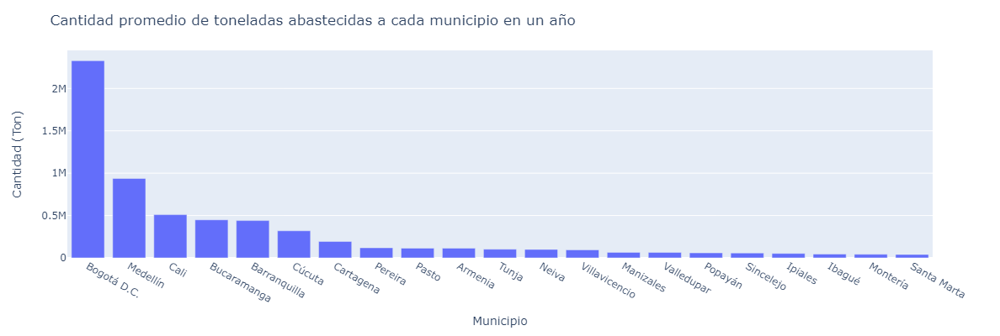

In [88]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año en cada municipio.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Municipio']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Municipio']).agg({'Cant Ton' :'mean'}).reset_index()
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
fig = px.bar(df,x='Municipio', y="Cant Ton",
             height=400)
fig.update_yaxes(title = "Cantidad (Ton)")
fig.update_layout(title_text = "Cantidad promedio de toneladas abastecidas a cada municipio en un año")
fig.show()

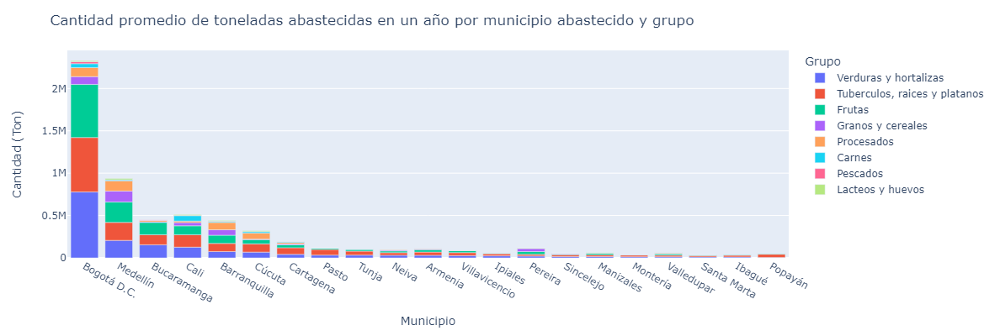

In [89]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año en cada municipio.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Municipio','Grupo']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Municipio','Grupo']).agg({'Cant Ton' :'mean'}).reset_index()
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
fig = px.bar(df,x='Municipio', y="Cant Ton",
             color = 'Grupo',
             height=400)
fig.update_yaxes(title = "Cantidad (Ton)")
fig.update_layout(title_text = "Cantidad promedio de toneladas abastecidas en un año por municipio abastecido y grupo")
fig.show()

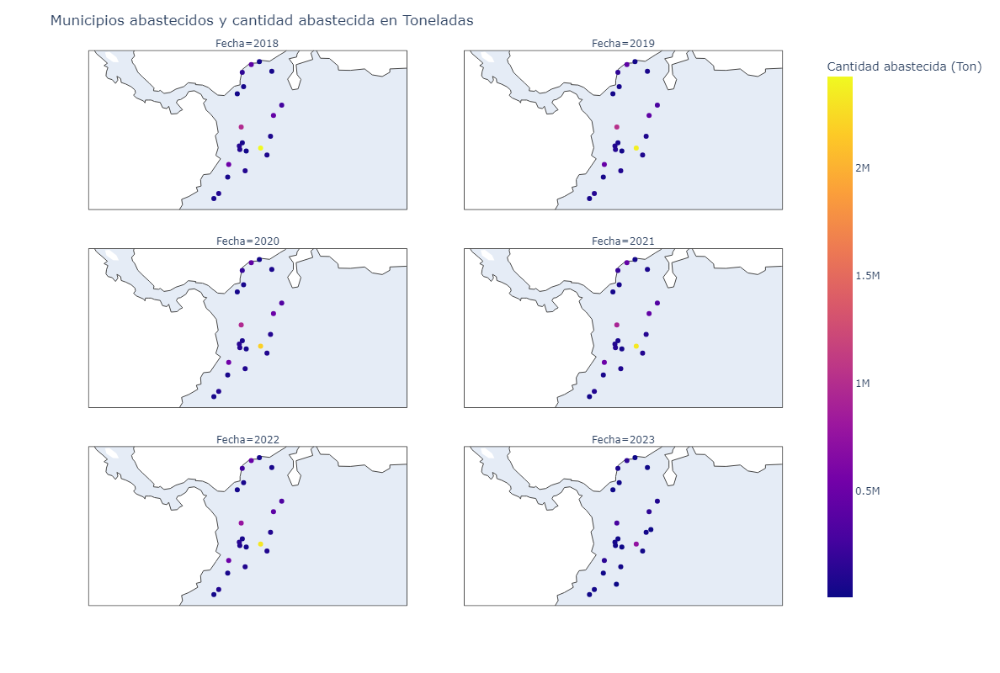

In [90]:
df = abastecimiento_df.groupby([abastecimiento_df['Fecha'].dt.year, 'Departamento','Municipio', 'Longitud', 'Latitud']).agg({'Cant Ton':'sum'}).reset_index()
fig = px.scatter_geo(df, lon="Longitud", lat="Latitud",
                     color = "Cant Ton",
                     facet_col = "Fecha",
                     facet_col_wrap = 2,
                     center = {'lat': df['Latitud'].mean(),'lon': df['Longitud'].mean()},
                     hover_name="Municipio",
                     fitbounds='locations',
                     labels = {'Cant Ton':'Cantidad abastecida (Ton)'},
                     height = 800
                    )
fig.update_layout(title_text = "Municipios abastecidos y cantidad abastecida en Toneladas")
fig.show()

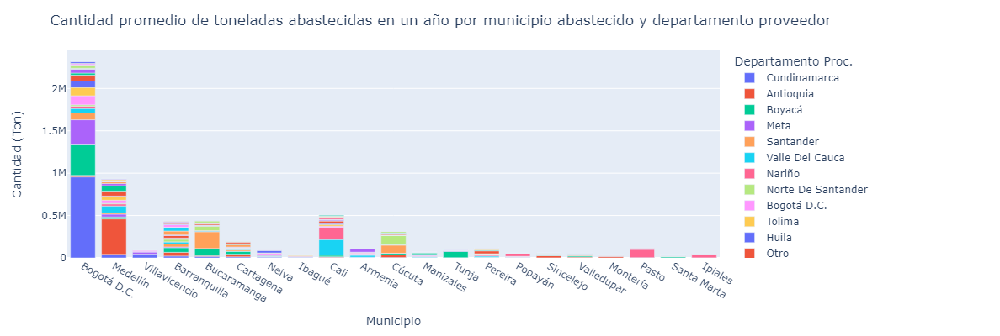

In [91]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año en cada municipio.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Municipio','Departamento Proc.']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Municipio','Departamento Proc.']).agg({'Cant Ton' :'mean'}).reset_index()
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
fig = px.bar(df,x='Municipio', y="Cant Ton",
             color = 'Departamento Proc.',
             height=400)
fig.update_yaxes(title = "Cantidad (Ton)")
fig.update_layout(title_text = "Cantidad promedio de toneladas abastecidas en un año por municipio abastecido y departamento proveedor")
fig.show()

In [92]:
proveedores = set(abastecimiento_df['Departamento Proc.'].unique())
for municipio in list(df['Municipio'].unique()):
    proveedores_municipio = set(df[df['Municipio']==municipio]['Departamento Proc.'].unique())
    if proveedores.intersection(proveedores_municipio) == proveedores:
        print(municipio, 'es abastecido por todos los departamentos proveedores')
        

Bogotá D.C. es abastecido por todos los departamentos proveedores


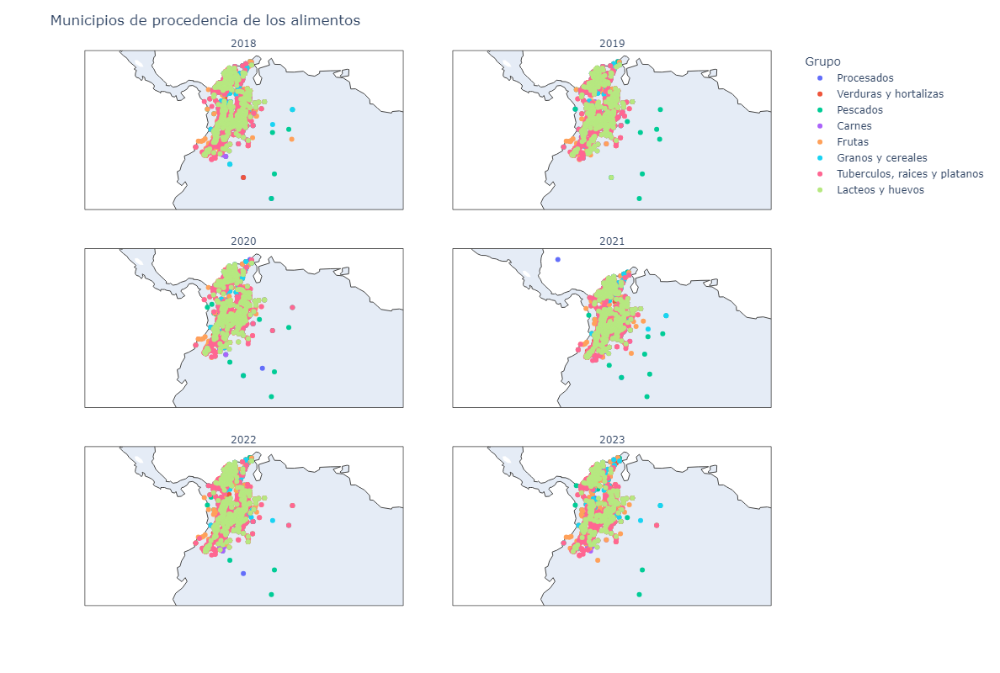

In [93]:
#Agrupamos por año y la localización de los municipios que abastecen sumando la cantidad en toneladas abastecida
df = abastecimiento_df.groupby([abastecimiento_df['Fecha'].dt.year, 'Departamento Proc.','Municipio Proc.', 'Longitud Proc.', 'Latitud Proc.', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
#Eliminamos los alimentos importados
df = df[df['Departamento Proc.'] != 'Otro'] 
fig = px.scatter_geo(df, lon="Longitud Proc.", lat="Latitud Proc.",
                     color = "Grupo",
                     facet_col = "Fecha",
                     facet_col_wrap = 2,
                     center = {'lat': df['Latitud Proc.'].mean(),'lon': df['Longitud Proc.'].mean()},
                     hover_name="Municipio Proc.",
                     # projection="natural earth",
                     fitbounds='locations',
                     height = 800
                    )
fig.update_layout(title_text = "Municipios de procedencia de los alimentos")
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

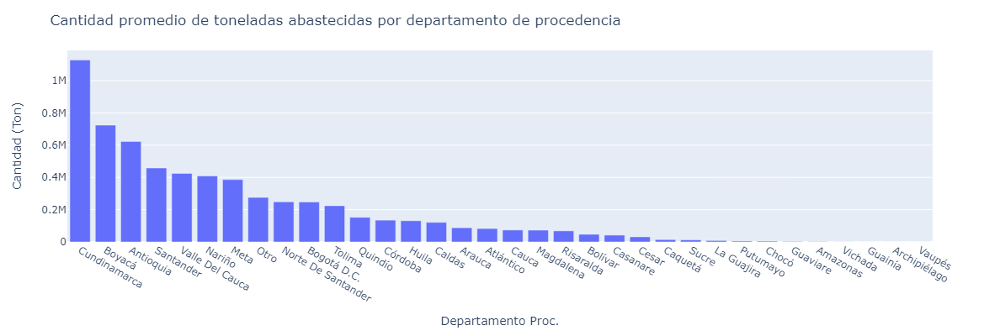

In [94]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año en cada departamento de Procedencia.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Departamento Proc.']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Departamento Proc.']).agg({'Cant Ton' :'mean'}).reset_index()
#Para la representación de los datos cambiemos el nombre del Archipiélago de San Andrés, Providencia y Santa Catalina
df.loc[df['Departamento Proc.'].str.contains('San Andrés'), 'Departamento Proc.'] = 'Archipiélago'
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
fig = px.bar(df,x='Departamento Proc.', y="Cant Ton",
             height=400)
fig.update_yaxes(title = "Cantidad (Ton)")
fig.update_layout(title_text = "Cantidad promedio de toneladas abastecidas por departamento de procedencia")
fig.show()

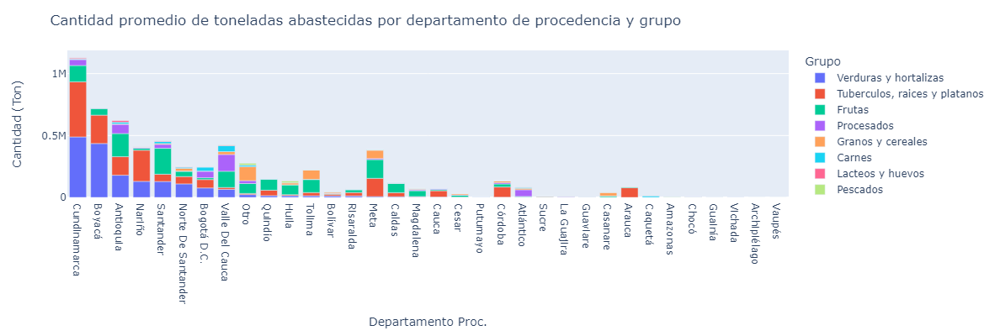

In [95]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
#Sumamos la cantidad abastecida por cada año en cada departamento de Procedencia.
df = df.groupby([abastecimiento_df['Fecha'].dt.year, 'Departamento Proc.','Grupo']).agg({'Cant Ton' :'sum'}).reset_index()
#Luego hacemos la media de la cantidad abastecida en todos los años.
df = df.groupby(['Departamento Proc.','Grupo']).agg({'Cant Ton' :'mean'}).reset_index()
#Para la representación de los datos cambiemos el nombre del Archipiélago de San Andrés, Providencia y Santa Catalina
df.loc[df['Departamento Proc.'].str.contains('San Andrés'), 'Departamento Proc.'] = 'Archipiélago'
#Ordenamos las cantidades de menor a mayor.
df = df.sort_values('Cant Ton', ascending = False)
fig = px.bar(df,x='Departamento Proc.', y="Cant Ton",
             color = 'Grupo',
             height=400)
fig.update_yaxes(title = "Cantidad (Ton)")
fig.update_layout(title_text = "Cantidad promedio de toneladas abastecidas por departamento de procedencia y grupo")
fig.show()

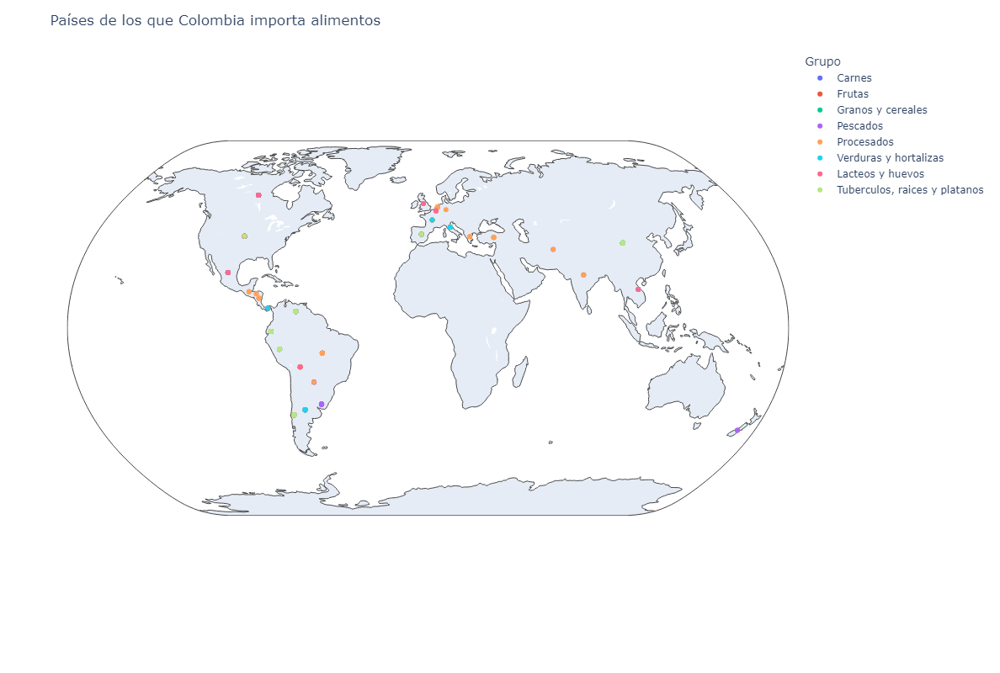

In [96]:
#Filtramos los alimnetos importados
df = abastecimiento_df[abastecimiento_df['Departamento Proc.'] == 'Otro'] 
#Agrupamos por año y país que abastece sumando la cantidad en toneladas abastecida
df = df.groupby([df['Fecha'].dt.year,'Municipio Proc.', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
#Agregamos el codigo iso para poder graficar
#Vamos a agregar para los alimentos importados el código ISO 3166-1 alpha-3 de cada país en la columna Municipio Proc.,
#Usamos el siguiente diccionario
country_codes = {
    'Chile': 'CHL',
    'United States Of America': 'USA',
    'Panama': 'PAN',
    'Ecuador': 'ECU',
    'Spain': 'ESP',
    'France': 'FRA',
    'Peru': 'PER',
    'Vietnam': 'VNM',
    'China': 'CHN',
    'Italy': 'ITA',
    'Bolivia': 'BOL',
    'Canada': 'CAN',
    'Brazil': 'BRA',
    'Mexico': 'MEX',
    'Argentina': 'ARG',
    'Venezuela': 'VEN',
    'Netherlands': 'NLD',
    'Scotland': 'SCT',
    'Guatemala': 'GTM',
    'Nicaragua': 'NIC',
    'Paraguay': 'PRY',
    'Uruguay': 'URY',
    'Belgium': 'BEL',
    'Afghanistan': 'AFG',
    'Honduras': 'HND',
    'India': 'IND',
    'Turkey': 'TUR',
    'Germany': 'DEU',
    'United Kingdom': 'GBR',
    'New Zealand': 'NZL',
    'Greece':'GRC'
}
for country in country_codes.items():
    df.loc[df['Municipio Proc.'] == country[0], 'Iso'] = country[1]


fig = px.scatter_geo(df, locations='Iso', color="Grupo",
                     hover_name="Municipio Proc.",
                     projection="natural earth",
                     height = 800)
fig.update_layout(title = "Países de los que Colombia importa alimentos")
fig.show()

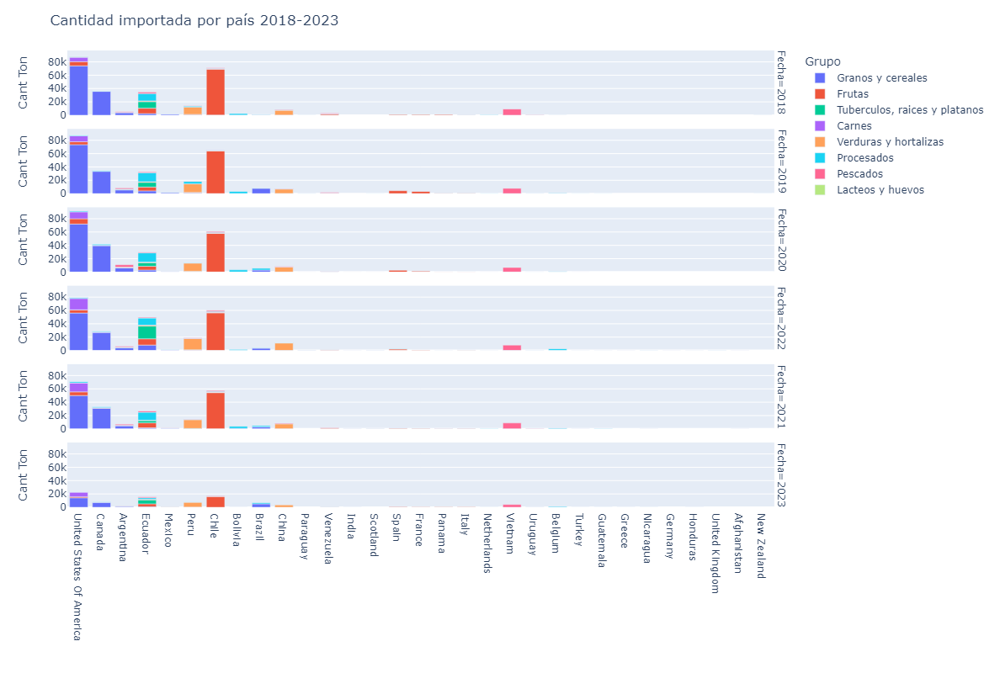

In [97]:
#Filtramos los alimnetos importados
df = abastecimiento_df[abastecimiento_df['Departamento Proc.'] == 'Otro'] 
#Agrupamos por fecha, municipio proc. y grupo
df = df.groupby([df['Fecha'].dt.year, 'Municipio Proc.', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
df = df.sort_values('Cant Ton', ascending = False)
fig = px.bar(df, x= 'Municipio Proc.', y = 'Cant Ton', color = 'Grupo', facet_row = 'Fecha', height = 800, labels = {'Municipio Proc.':''})
fig.update_layout(title_text = 'Cantidad importada por país 2018-2023')
fig.show()

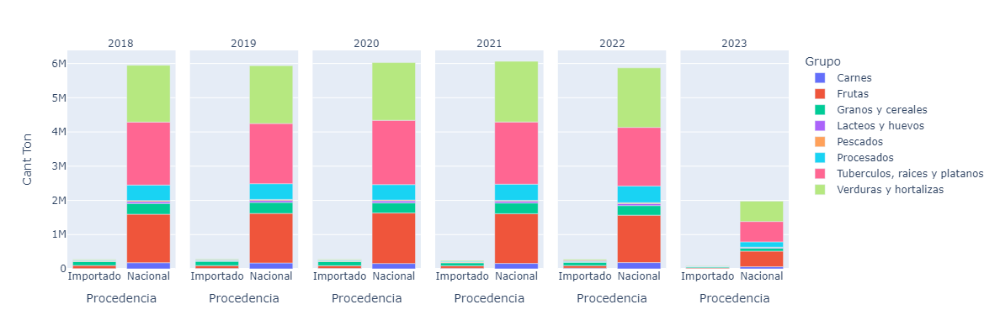

In [98]:
df = abastecimiento_df.loc[:,['Fecha','Departamento Proc.', 'Grupo','Cant Ton']]
df = df.groupby([df['Fecha'].dt.year, 'Departamento Proc.', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
df.loc[df['Departamento Proc.'] == 'Otro', 'Procedencia'] = 'Importado'
df.loc[df['Departamento Proc.'] != 'Otro', 'Procedencia'] = 'Nacional'
df = df.groupby(['Fecha', 'Procedencia', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
fig = px.bar(df, y ='Cant Ton',x='Procedencia', color='Grupo', facet_col = 'Fecha', height = 400)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

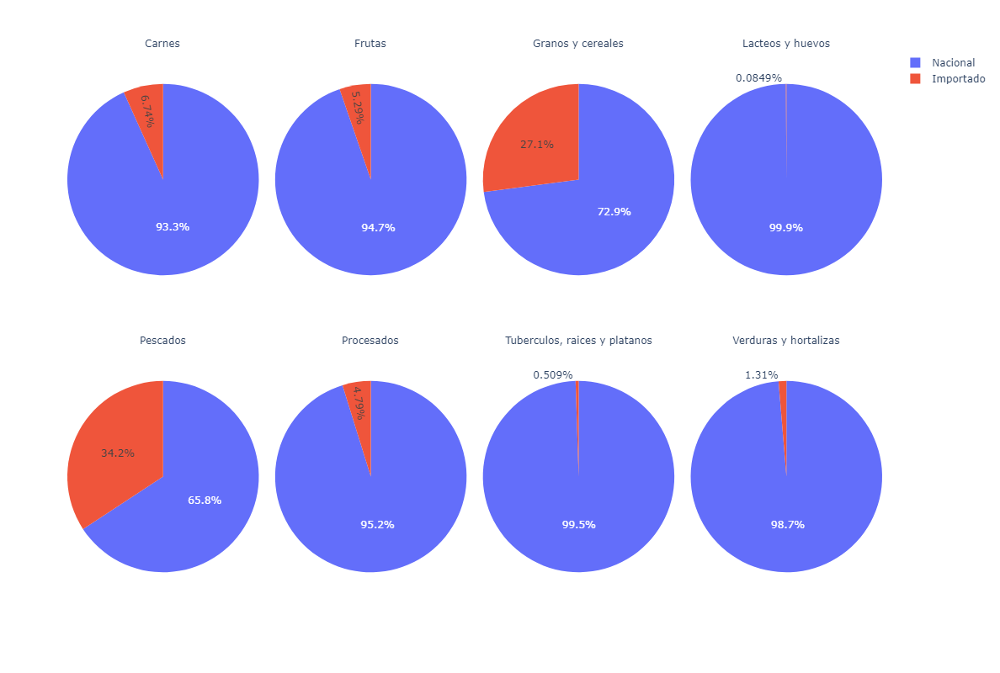

In [99]:
#Eliminamos los registros del año 2023 porque no corresponden a un año completo y afectarían el promedio que queremos obtener
df = abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
df = df.loc[:,['Fecha','Departamento Proc.', 'Grupo','Cant Ton']]
df = df.groupby([df['Fecha'].dt.year, 'Departamento Proc.', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
df.loc[df['Departamento Proc.'] == 'Otro', 'Procedencia'] = 'Importado'
df.loc[df['Departamento Proc.'] != 'Otro', 'Procedencia'] = 'Nacional'
df = df.groupby(['Fecha', 'Procedencia', 'Grupo']).agg({'Cant Ton':'sum'}).reset_index()
df = df.groupby(['Procedencia', 'Grupo']).agg({'Cant Ton':'mean'}).reset_index()
fig = px.pie(df, values ='Cant Ton',names ='Procedencia', facet_col = 'Grupo', facet_col_wrap=4, height = 800)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

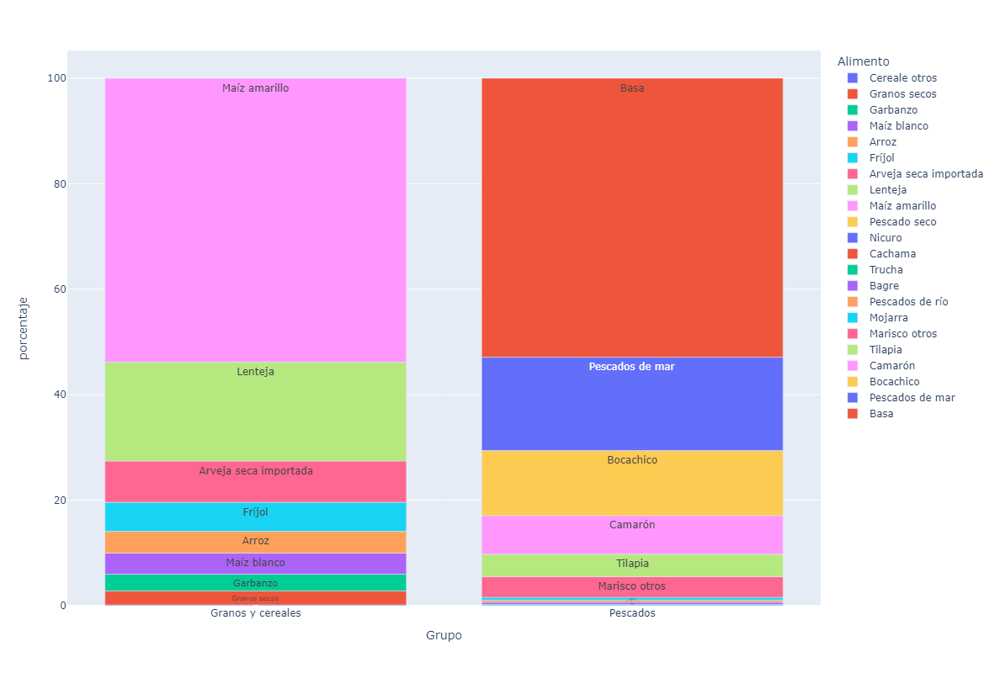

In [100]:
df=abastecimiento_df[abastecimiento_df['Fecha'] < '2023-01-01']
df=df[df['Departamento Proc.']=='Otro'].groupby([df['Fecha'].dt.year,'Grupo','Alimento']).agg({'Cant Ton':'sum'}).reset_index()
df =  df.groupby(['Grupo','Alimento']).agg({'Cant Ton':'mean'}).reset_index()
total = df.groupby('Grupo').agg({'Cant Ton':'sum'}).reset_index()
def porcentaje_grupo(row):
    row['porcentaje']= 100*(row['Cant Ton']/list(total[total['Grupo'] == row['Grupo']]['Cant Ton'])[0])
    return row
df = df.apply(porcentaje_grupo, axis = 1)
df = df[(df['Grupo'] == 'Pescados') | (df['Grupo'] == 'Granos y cereales')]
df = df.sort_values(['Grupo','porcentaje'])
fig = px.bar(df, x='Grupo', y='porcentaje', color = 'Alimento', text = 'Alimento', height=800)
fig.show()



In [101]:
df = abastecimiento_df[abastecimiento_df['Departamento Proc.']=='Otro']
for grupo in list(abastecimiento_df['Grupo'].unique()):
    alimentos = set(abastecimiento_df[abastecimiento_df['Grupo'] == grupo]['Alimento'].unique())
    alimentos_importados = set(df[df['Grupo'] == grupo]['Alimento'].unique())
    if alimentos == alimentos.intersection(alimentos_importados):
        print('El conjunto de alimentos del grupo', grupo,'que se importan y el conjunto de alimentos abastecidos son iguales')
    else:
        print('Del grupo', grupo, 'no se importan estos alimentos ', alimentos.difference(alimentos_importados))



Del grupo Verduras y hortalizas no se importan estos alimentos  {'Lechugas otras'}
Del grupo Frutas no se importan estos alimentos  {'Papaya hawaiana', 'Gulupa', 'Patilla baby'}
Del grupo Tuberculos, raices y platanos no se importan estos alimentos  {'Ñame', 'Papa sabanera', 'Papa nevada'}
El conjunto de alimentos del grupo Granos y cereales que se importan y el conjunto de alimentos abastecidos son iguales
Del grupo Lacteos y huevos no se importan estos alimentos  {'Leche cruda', 'Huevo otros'}
Del grupo Procesados no se importan estos alimentos  {'Agua envasada'}
El conjunto de alimentos del grupo Pescados que se importan y el conjunto de alimentos abastecidos son iguales
Del grupo Carnes no se importan estos alimentos  {'Cerdo en pie', 'Pollo en pie', 'Res en pie', 'Gallina en pie'}


### Precios

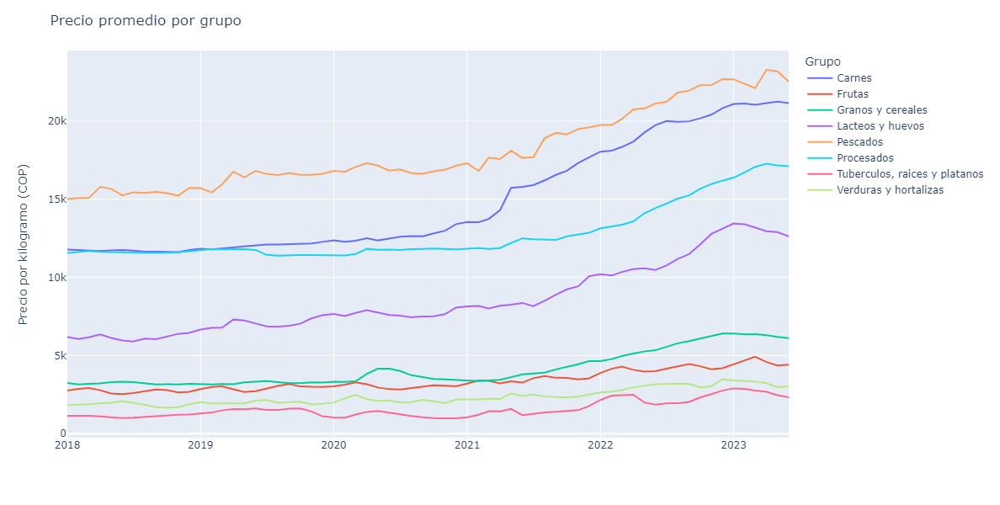

In [102]:
fig = go.Figure()
df = precios_df.groupby(['Fecha','Grupo']).agg({'Precio por kilogramo':'mean'}).reset_index()
fig = px.line(df,
              x = 'Fecha',
              y = 'Precio por kilogramo',
             color = 'Grupo')
fig.update_layout(height= 600,title_text="Precio promedio por grupo")
fig.update_yaxes(title = 'Precio por kilogramo (COP)')
fig.update_xaxes(title = '')
fig.show()

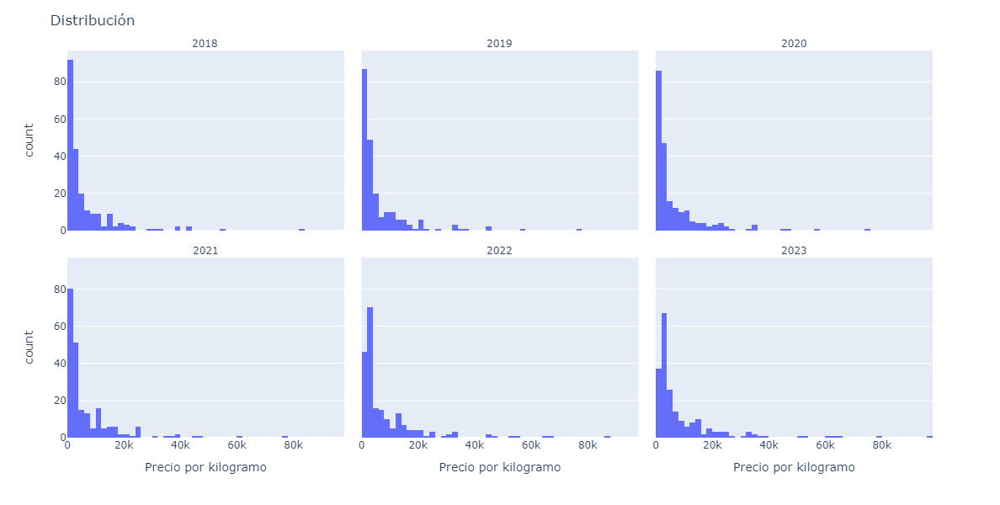

In [103]:
df= precios_df.groupby([precios_df['Fecha'].dt.year,'Grupo','Alimento']).agg({'Precio por kilogramo':'mean'}).reset_index()
fig = px.histogram(df, x ='Precio por kilogramo', facet_col = 'Fecha', facet_col_wrap = 3)
fig.update_layout(title='Distribución', height = 600)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

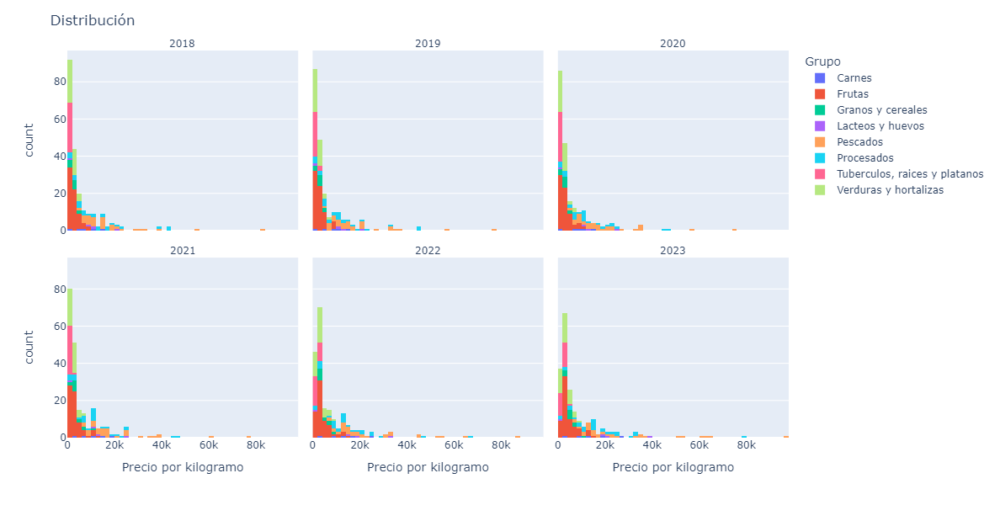

In [104]:
df= precios_df.groupby([precios_df['Fecha'].dt.year,'Grupo','Alimento']).agg({'Precio por kilogramo':'mean'}).reset_index()
fig = px.histogram(df, x ='Precio por kilogramo',color ='Grupo', facet_col = 'Fecha', facet_col_wrap = 3)
fig.update_layout(title='Distribución', height = 600)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

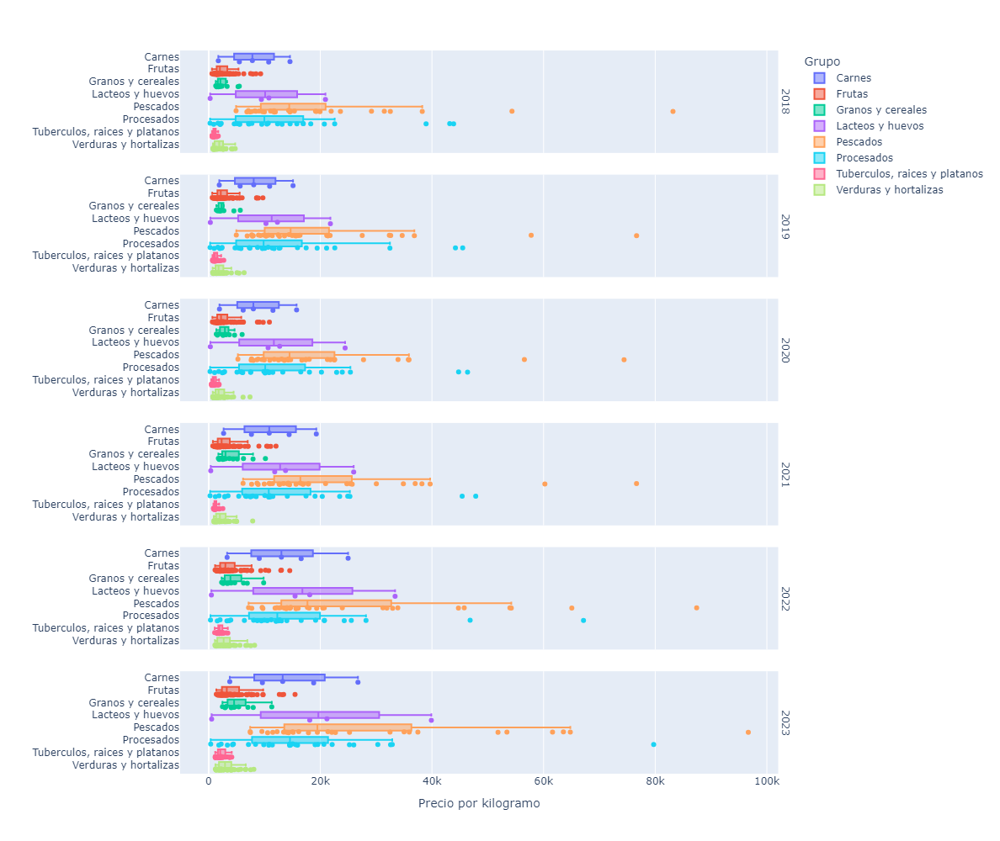

In [105]:
df = precios_df.groupby([precios_df['Fecha'].dt.year, 'Grupo','Alimento']).agg({'Precio por kilogramo':'mean'}).reset_index()
# df = precios_df.groupby(['Grupo','Alimento']).agg({'Precio por kilogramo':'mean'}).reset_index()
fig = px.box(df, y= 'Grupo', x='Precio por kilogramo', points = 'all', color = 'Grupo', height = 1000, facet_row = 'Fecha', hover_data='Alimento') 
fig.update_yaxes(title = '')
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

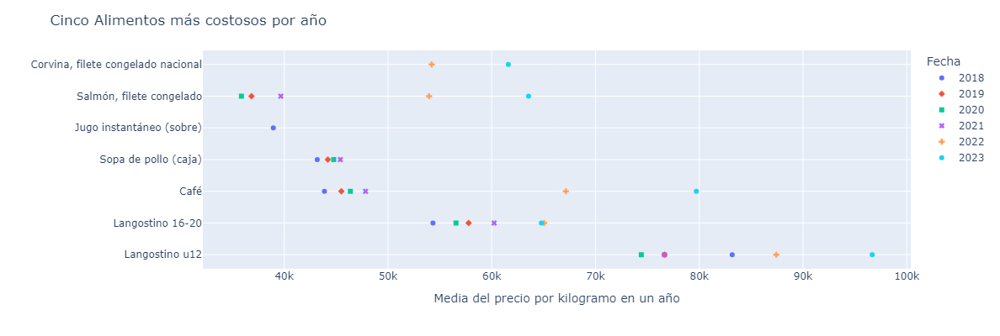

In [116]:
df = precios_df.groupby([precios_df['Fecha'].dt.year,'Alimento']).agg({'Precio por kilogramo':'mean'}).reset_index()
df2 = pd.DataFrame(columns = ['Fecha','Alimento','Precio por kilogramo'])
for year in list(precios_df['Fecha'].dt.year.unique()):
        df2 = pd.concat([df2,df[df['Fecha'] == year].sort_values('Precio por kilogramo', ascending = False).head()], ignore_index = True)
fig = px.scatter(df2,x='Precio por kilogramo', y ='Alimento',color = 'Fecha',symbol='Fecha', height = 400)
fig.update_layout(title = 'Cinco Alimentos más costosos por año',
                  xaxis_title = 'Media del precio por kilogramo en un año',
                  yaxis_title = '')
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

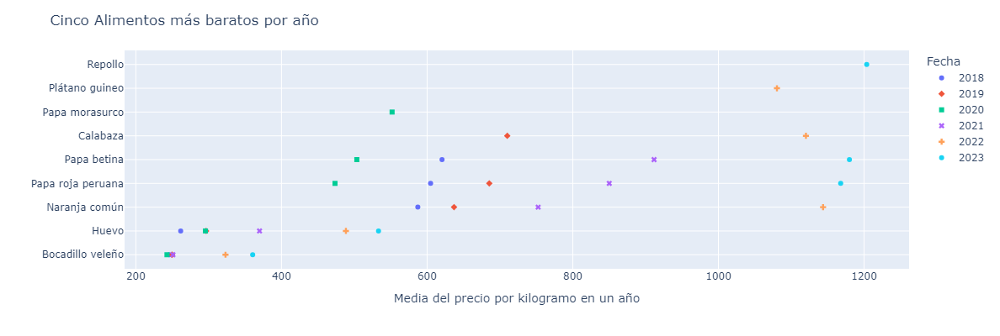

In [117]:
df = precios_df.groupby([precios_df['Fecha'].dt.year,'Alimento']).agg({'Precio por kilogramo':'mean'}).reset_index()
df2 = pd.DataFrame(columns = ['Fecha','Alimento','Precio por kilogramo'])
for year in list(precios_df['Fecha'].dt.year.unique()):
        df2 = pd.concat([df2,df[df['Fecha'] == year].sort_values('Precio por kilogramo', ascending = True).head()], ignore_index = True)
fig = px.scatter(df2,x='Precio por kilogramo', y ='Alimento',color = 'Fecha',symbol='Fecha', height = 400)
fig.update_layout(title = 'Cinco Alimentos más baratos por año',
                  xaxis_title = 'Media del precio por kilogramo en un año',
                  yaxis_title = '')
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

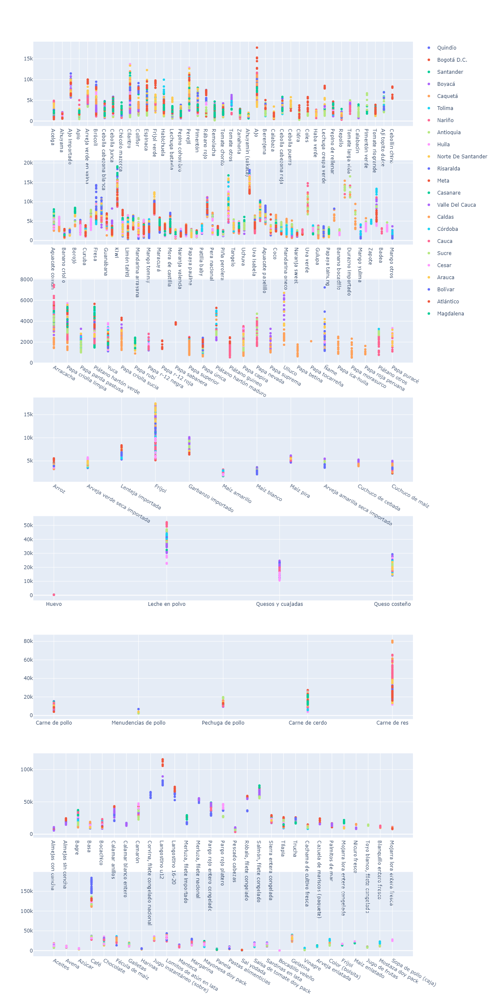

In [188]:
from plotly.subplots import make_subplots
fig = make_subplots(rows = 8, cols=1)
for i,grupo in enumerate(list(precios_df['Grupo'].unique())):
    fig2 = px.scatter(precios_df[(precios_df['Fecha'].dt.year == 2023) & (precios_df['Grupo'] == grupo)], 
                            x = 'Alimento',y='Precio por kilogramo', color = 'Departamento', height = 800, title = grupo)
   
    fig2.update_layout(showlegend = False)
    for trace in fig2.to_dict()['data']:
        fig.add_trace(trace, row = i+1, col = 1)

for i,grupo in enumerate(list(precios_df['Grupo'].unique())):
    if i!=0:
        fig.update_traces(showlegend = False, row = i+1)
    
fig.update_layout(height = 2400)
fig.show()


In [157]:
len(precios_df['Departamento'].unique())

24